# notebook to generate UMAPs 

- last updated: 6/5/2024
- 

# Set up - import libraries, datasets, and annotations

In [6]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import os
import re

In [7]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault) #Reset rcParams to default

# Editable text and proper LaTeX fonts in illustrator
# matplotlib.rcParams['ps.useafm'] = True
# Editable fonts. 42 is the magic number
mpl.rcParams['pdf.fonttype'] = 42
sns.set(style='whitegrid', context='paper')

# Plotting style function (run this before plotting the final figure)
def set_plotting_style():
    plt.style.use('seaborn-paper')
    plt.rc('axes', labelsize=12)
    plt.rc('axes', titlesize=12)
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    plt.rc('legend', fontsize=10)
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('xtick.major', pad=2)
    plt.rc('ytick.major', pad=2)
    plt.rc('mathtext', fontset='stixsans', sf='sansserif')
    plt.rc('figure', figsize=[10,9])
    plt.rc('svg', fonttype='none')

In [8]:
figpath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/zebrahub-multiome-analysis/figures/umaps/"
os.makedirs(figpath, exist_ok=True)
sc.settings.figdir = figpath

In [31]:
adata = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/integrated_RNA_ATAC_counts_RNA_formatted_excxg_zscape_labels.h5ad")
adata

AnnData object with n_obs × n_vars = 95196 × 32057
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters', 'data_source', 'annotation_ML', 'scANVI_zscape'
    var: 'features'
    uns: 'annotation_ML_colors', 'dataset_colors', 'global_annotation_colors', 'log1p', 'scANVI_zscape_colors'
    obsm: 'X_umap', 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'

In [4]:
annotation = pd.read_csv("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/annotations/annotation_ML_06052024.txt", index_col=0, sep="\t")
annotation

,annotation_ML_v4
AAACAGCCACCTAAGC-1_1,epidermis
AAACAGCCAGGGAGGA-1_1,pronephros
AAACAGCCATAGACCC-1_1,hindbrain
AAACATGCAAACTCAT-1_1,spinal_cord
AAACATGCAAGGACCA-1_1,neural_optic2
...,...
TTTGTGTTCCCTCAGT-1_7,tail_bud
TTTGTTGGTACCTTAC-1_7,lateral_plate_mesoderm
TTTGTTGGTATTGAGT-1_7,neural_posterior
TTTGTTGGTGCGCGTA-1_7,endocrine_pancreas


In [32]:
adata.obs["annotation_ML"] = annotation["annotation_ML_v4"]
adata.obs["annotation_ML"]

AAACAGCCACCTAAGC-1_1                 epidermis
AAACAGCCAGGGAGGA-1_1                pronephros
AAACAGCCATAGACCC-1_1                 hindbrain
AAACATGCAAACTCAT-1_1               spinal_cord
AAACATGCAAGGACCA-1_1             neural_optic2
                                 ...          
TTTGTGTTCCCTCAGT-1_7                  tail_bud
TTTGTTGGTACCTTAC-1_7    lateral_plate_mesoderm
TTTGTTGGTATTGAGT-1_7          neural_posterior
TTTGTTGGTGCGCGTA-1_7        endocrine_pancreas
TTTGTTGGTTAAGGCC-1_7                   somites
Name: annotation_ML, Length: 95196, dtype: object

In [33]:
adata.obs.annotation_ML.unique()

array(['epidermis', 'pronephros', 'hindbrain', 'spinal_cord',
       'neural_optic2', 'neural_floor_plate', 'neural_crest2', 'PSM',
       'optic_cup', 'lateral_plate_mesoderm',
       'midbrain_hindbrain_boundary2', 'neural_telencephalon',
       'differentiating_neurons', 'muscle', 'fast_muscle',
       'low_quality_cells', 'heart_myocardium', 'somites', 'NMPs',
       'epidermis2', 'pharyngeal_arches', 'floor_plate2',
       'hemangioblasts', 'neural_posterior', 'floor_plate', 'tail_bud',
       'endoderm', 'midbrain_hindbrain_boundary', 'neural_crest',
       'neural_optic', 'hematopoietic_vasculature', 'endocrine_pancreas',
       'hatching_gland', 'neurons', 'notochord', 'pronephros2',
       'enteric_neurons', 'epidermis3', 'epidermis4', 'neural',
       'primordial_germ_cells'], dtype=object)

In [8]:
# # standardize the naming convention (typo fix)
# # Define the mapping of old category names to new category names
# category_mapping = {
#     "spinal_chord": "spinal_cord",
#     "neural_unknown": "neural"
# }

# # Apply the mapping to change the category names
# adata.obs["annotation_ML"].replace(category_mapping, inplace=True)

In [34]:
# filter out the low quality cells (annotated as either "nan" or "low_quality_cells")
multiome = adata[adata.obs.annotation_ML!="low_quality_cells"]
multiome

View of AnnData object with n_obs × n_vars = 94562 × 32057
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters', 'data_source', 'annotation_ML', 'scANVI_zscape'
    var: 'features'
    uns: 'annotation_ML_colors', 'dataset_colors', 'global_annotation_colors', 'log1p', 'scANVI_zscape_colors'
    obsm: 'X_umap', 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'

In [36]:
# create a list of celltypes from annotation_ML (fine annotation by Merlin Lange)
list_celltypes_ML = multiome.obs.annotation_ML.unique().tolist()

# Remove NaNs from the list
elements = [el for el in list_celltypes_ML if isinstance(el, str)]

# Function to remove numbers
def remove_numbers(name):
    return re.sub(r'\d+', '', name)

# Create the dictionary
merged_dict = {}
for element in elements:
    merged_dict[element] = remove_numbers(element)

# Display the dictionary
merged_dict

{'epidermis': 'epidermis',
 'pronephros': 'pronephros',
 'hindbrain': 'hindbrain',
 'spinal_cord': 'spinal_cord',
 'neural_optic2': 'neural_optic',
 'neural_floor_plate': 'neural_floor_plate',
 'neural_crest2': 'neural_crest',
 'PSM': 'PSM',
 'optic_cup': 'optic_cup',
 'lateral_plate_mesoderm': 'lateral_plate_mesoderm',
 'midbrain_hindbrain_boundary2': 'midbrain_hindbrain_boundary',
 'neural_telencephalon': 'neural_telencephalon',
 'differentiating_neurons': 'differentiating_neurons',
 'muscle': 'muscle',
 'fast_muscle': 'fast_muscle',
 'heart_myocardium': 'heart_myocardium',
 'somites': 'somites',
 'NMPs': 'NMPs',
 'epidermis2': 'epidermis',
 'pharyngeal_arches': 'pharyngeal_arches',
 'floor_plate2': 'floor_plate',
 'hemangioblasts': 'hemangioblasts',
 'neural_posterior': 'neural_posterior',
 'floor_plate': 'floor_plate',
 'tail_bud': 'tail_bud',
 'endoderm': 'endoderm',
 'midbrain_hindbrain_boundary': 'midbrain_hindbrain_boundary',
 'neural_crest': 'neural_crest',
 'neural_optic': 'n

In [37]:
# generate a coarse-grained annotation - "annotation_ML_coarse"
multiome.obs["annotation_ML_coarse"] = multiome.obs["annotation_ML"].map(merged_dict)

multiome.obs["annotation_ML_coarse"]

/tmp/ipykernel_1624030/1848327900.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  multiome.obs["annotation_ML_coarse"] = multiome.obs["annotation_ML"].map(merged_dict)


AAACAGCCACCTAAGC-1_1                 epidermis
AAACAGCCAGGGAGGA-1_1                pronephros
AAACAGCCATAGACCC-1_1                 hindbrain
AAACATGCAAACTCAT-1_1               spinal_cord
AAACATGCAAGGACCA-1_1              neural_optic
                                 ...          
TTTGTGTTCCCTCAGT-1_7                  tail_bud
TTTGTTGGTACCTTAC-1_7    lateral_plate_mesoderm
TTTGTTGGTATTGAGT-1_7          neural_posterior
TTTGTTGGTGCGCGTA-1_7        endocrine_pancreas
TTTGTTGGTTAAGGCC-1_7                   somites
Name: annotation_ML_coarse, Length: 94562, dtype: object

In [38]:
multiome.obs["annotation_ML_coarse"].unique()

array(['epidermis', 'pronephros', 'hindbrain', 'spinal_cord',
       'neural_optic', 'neural_floor_plate', 'neural_crest', 'PSM',
       'optic_cup', 'lateral_plate_mesoderm',
       'midbrain_hindbrain_boundary', 'neural_telencephalon',
       'differentiating_neurons', 'muscle', 'fast_muscle',
       'heart_myocardium', 'somites', 'NMPs', 'pharyngeal_arches',
       'floor_plate', 'hemangioblasts', 'neural_posterior', 'tail_bud',
       'endoderm', 'hematopoietic_vasculature', 'endocrine_pancreas',
       'hatching_gland', 'neurons', 'notochord', 'enteric_neurons',
       'neural', 'primordial_germ_cells'], dtype=object)

In [98]:
# # Cell types
# cell_types = [
#        'epidermis', 'pronephros', 'hindbrain', 'spinal_cord',
#        'neural_optic', 'neural_floor_plate', 'neural_crest', 'PSM',
#        'optic_cup', 'lateral_plate_mesoderm',
#        'midbrain_hindbrain_boundary', 'neural_telencephalon',
#        'differentiating_neurons', 'muscle', 'fast_muscle',
#        'heart_myocardium', 'somites', 'NMPs', 'pharyngeal_arches',
#        'floor_plate', 'hemangioblasts', 'neural_posterior', 'tail_bud',
#        'endoderm', 'hematopoietic_vasculature', 'endocrine_pancreas',
#        'hatching_gland', 'neurons', 'notochord', 'enteric_neurons',
#        'neural', 'primordial_germ_cells'
# ]

cell_types = multiome.obs.annotation_ML.unique().to_list()
cell_types

/tmp/ipykernel_1624030/1619132338.py:15: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  cell_types = multiome.obs.annotation_ML.unique().to_list()


['epidermis',
 'pronephros',
 'hindbrain',
 'spinal_cord',
 'neural_optic2',
 'neural_floor_plate',
 'neural_crest2',
 'PSM',
 'optic_cup',
 'lateral_plate_mesoderm',
 'midbrain_hindbrain_boundary2',
 'neural_telencephalon',
 'differentiating_neurons',
 'muscle',
 'fast_muscle',
 'heart_myocardium',
 'somites',
 'NMPs',
 'epidermis2',
 'pharyngeal_arches',
 'floor_plate2',
 'hemangioblasts',
 'neural_posterior',
 'floor_plate',
 'tail_bud',
 'endoderm',
 'midbrain_hindbrain_boundary',
 'neural_crest',
 'neural_optic',
 'hematopoietic_vasculature',
 'endocrine_pancreas',
 'hatching_gland',
 'neurons',
 'notochord',
 'pronephros2',
 'enteric_neurons',
 'epidermis3',
 'epidermis4',
 'neural',
 'primordial_germ_cells']

<Figure size 1000x200 with 0 Axes>

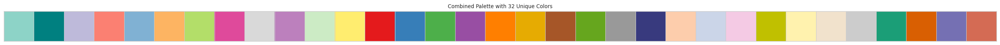

In [80]:
# Generate a color palette with 33 distinct colors
# Start with the seaborn colorblind palette and extend it
base_palette = sns.color_palette("Set3", 12)
extended_palette = sns.color_palette("Set1", 9) + sns.color_palette("Pastel2", 8) + sns.color_palette("Dark2", 8)

# Combine the base and extended palettes to get 33 unique colors
combined_palette = base_palette + extended_palette

# manually swap some colors from the front with the ones from the back
teal_color = (0.0, 0.5019607843137255, 0.5019607843137255)  # RGB for teal
combined_palette[-1] = teal_color  # Replace the light yellow with teal

combined_palette[1] = combined_palette[-1]
combined_palette[17] = combined_palette[-3]
combined_palette[19] = combined_palette[-4]
combined_palette[32] = (213/256, 108/256, 85/256)
combined_palette[7] = (0.875, 0.29296875, 0.609375)
combined_palette[25] = (0.75390625, 0.75390625, 0.0)
combined_palette[21] = (0.22265625, 0.23046875, 0.49609375)

combined_palette = combined_palette[:33]  # Ensure we only take the first 33 colors

# Verify the palette length
assert len(combined_palette) == 33, "The palette must have exactly 33 colors"

# Plot the color palette
plt.figure(figsize=(10, 2))
sns.palplot(combined_palette)
plt.title("Combined Palette with 32 Unique Colors")
plt.show()

# Print the dictionary to verify
#print(cell_type_color_dict)

In [100]:
# extract a list of celltypes
cell_types = multiome.obs.annotation_ML_coarse.unique().tolist()
cell_types

# extract a list of colors (palette)
color_palettes = multiome.uns["annotation_ML_coarse_colors"]

# Create a dictionary mapping cell types to colors
cell_type_color_dict = {cell_type: combined_palette[i] for i, cell_type in enumerate(cell_types)}
cell_type_color_dict

{'epidermis': (0.5529411764705883, 0.8274509803921568, 0.7803921568627451),
 'pronephros': (0.0, 0.5019607843137255, 0.5019607843137255),
 'hindbrain': (0.7450980392156863, 0.7294117647058823, 0.8549019607843137),
 'spinal_cord': (0.984313725490196, 0.5019607843137255, 0.4470588235294118),
 'neural_optic': (0.5019607843137255, 0.6941176470588235, 0.8274509803921568),
 'neural_floor_plate': (0.9921568627450981,
  0.7058823529411765,
  0.3843137254901961),
 'neural_crest': (0.7019607843137254, 0.8705882352941177, 0.4117647058823529),
 'PSM': (0.875, 0.29296875, 0.609375),
 'optic_cup': (0.8509803921568627, 0.8509803921568627, 0.8509803921568627),
 'lateral_plate_mesoderm': (0.7372549019607844,
  0.5019607843137255,
  0.7411764705882353),
 'midbrain_hindbrain_boundary': (0.8, 0.9215686274509803, 0.7725490196078432),
 'neural_telencephalon': (1.0, 0.9294117647058824, 0.43529411764705883),
 'differentiating_neurons': (0.8941176470588236,
  0.10196078431372549,
  0.10980392156862745),
 'musc

<Figure size 1000x200 with 0 Axes>

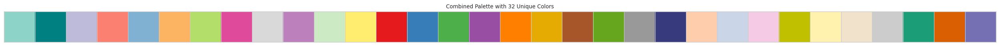

In [103]:
# Plot the color palette
plt.figure(figsize=(10, 2))
sns.palplot(cell_type_color_dict.values())
plt.title("Combined Palette with 32 Unique Colors")
plt.show()

<Figure size 1000x200 with 0 Axes>

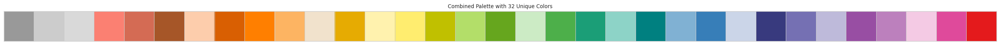

In [110]:
# visually inspect the colormap by sorting based on the HSV scale
from colorsys import rgb_to_hsv

# Convert RGB to HSV and sort by HSV values
sorted_palette = sorted(combined_palette, key=lambda color: rgb_to_hsv(color[0], color[1], color[2]))

# Visualize the sorted palette to manually check for similarity
# Plot the color palette
plt.figure(figsize=(10, 2))
sns.palplot(sorted_palette)
plt.title("Combined Palette with 32 Unique Colors")
plt.show()

<Figure size 1000x200 with 0 Axes>

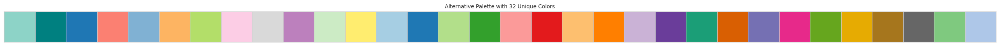

In [81]:
# # Define different palettes to combine
# palettes = [
#     sns.color_palette("Set3", 14),
#     sns.color_palette("Paired", 10),
#     sns.color_palette("Dark2", 11),
#     sns.color_palette("Accent",5)
# ]

# # Combine and deduplicate colors
# alternative_palette = []
# seen_colors = set()

# for palette in palettes:
#     for color in palette:
#         if color not in seen_colors:
#             alternative_palette.append(color)
#             seen_colors.add(color)
#         if len(alternative_palette) >= 32:
#             break
#     if len(alternative_palette) >= 32:
#         break
        
# # Suppose the light yellow is the 10th color in the palette (9th index, as indexing is 0-based)
# # and you want to replace it with teal color
# teal_color = (0.0, 0.5019607843137255, 0.5019607843137255)  # RGB for teal
# alternative_palette[1] = teal_color  # Replace the light yellow with teal

# # Identify and replace similar light purple colors
# similar_purples_indices = [2,31]  # Example indices for similar purples
# replacement_colors = sns.color_palette("tab20", 3)

# for idx, replacement in zip(similar_purples_indices, replacement_colors):
#     alternative_palette[idx] = replacement

# # Assign colors to cell types
# # custom_palette = {cell_type: color for cell_type, color in zip(cell_types, combined_palette)}

# # Plot the color palette
# plt.figure(figsize=(10, 2))
# sns.palplot(alternative_palette)
# plt.title("Alternative Palette with 32 Unique Colors")
# plt.show()

## generation of UMAPs

## ATAC modality

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


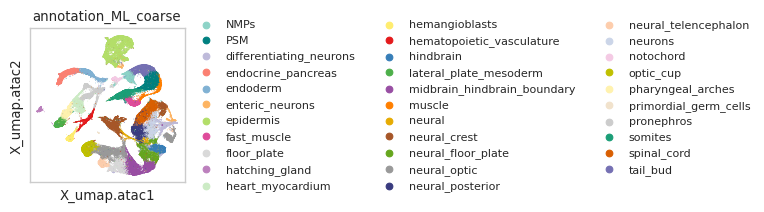

In [111]:
# UMAP (integrated_ATAC) colored by the cell types (annotation_ML_coarse)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(multiome, basis="X_umap.atac",color=["annotation_ML_coarse"], palette=combined_palette,
               legend_fontsize=8,save="_integrated_ATAC_celltypes.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


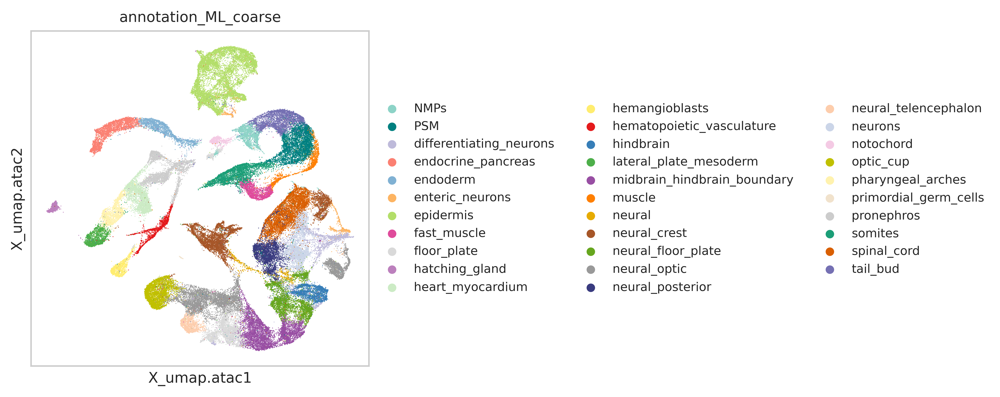

In [113]:
# UMAP (integrated_ATAC) colored by the cell types (annotation_ML_coarse)
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(multiome, basis="X_umap.atac",color=["annotation_ML_coarse"], palette=combined_palette,
               legend_fontsize=8,save="_integrated_ATAC_celltypes.png")

In [87]:
# shuffle the cell ordering in the adata (and make a copied adata object just fot plotting)
np.random.seed(42)
shuffled_indices = np.random.permutation(multiome.n_obs)

adata_shuffled = multiome[shuffled_indices].copy()
adata_shuffled.obsm["X_umap.atac"] = adata.obsm["X_umap.atac"][shuffled_indices]

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


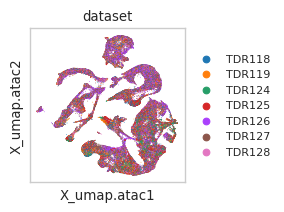

In [89]:
# UMAP (integrated_ATAC) colored with batch
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.atac", color=["dataset"],
               legend_fontsize=8,save="_integrated_ATAC_batch.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


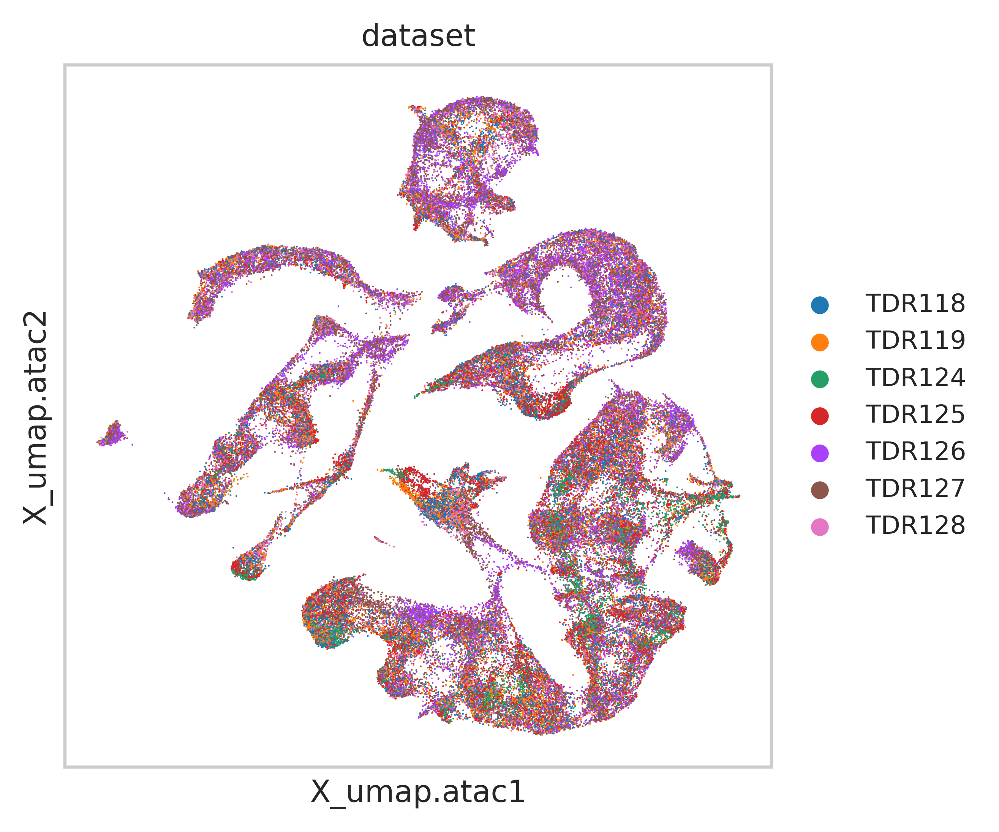

In [90]:
# UMAP (integrated_ATAC) colored with batch
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.atac", color=["dataset"],
               legend_fontsize=8,save="_integrated_ATAC_batch.png")

In [91]:
dict_dev_stages = {
    "TDR118":"15somites",
    "TDR119":"15somites",
    "TDR124":"30somites",
    "TDR125":"20somites",
    "TDR126":"0somites",
    "TDR127":"5somites",
    "TDR128":"10somites"
}

In [94]:
adata_shuffled.obs["dev_stage"] = adata_shuffled.obs["dataset"].map(dict_dev_stages)
adata_shuffled.obs["dev_stage"]

CTAACCTGTAGTCAAT-1_1    15somites
TTTAACCTCTAGCTTT-1_2    15somites
GGTGAGCCAAAGGTAC-1_2    15somites
ATGGCTAGTGAAGCCT-1_5     0somites
CGCACAATCAGGTTTA-1_6     5somites
                          ...    
CTGGATGTCCGGAACC-1_1    15somites
CCTTGCGTCTAATCTC-1_5     0somites
GGCGTTATCTACCTAT-1_6     5somites
ACAACAACAGCTTAAT-1_1    15somites
ATAATGGCAATTTAGC-1_2    15somites
Name: dev_stage, Length: 94562, dtype: object

In [95]:
# colormap
# Define the timepoints
timepoints = ["0somites", "5somites", "10somites", "15somites", "20somites", "30somites"]

# Load the "viridis" colormap
viridis = plt.cm.get_cmap('viridis', 256)

# Select a subset of the colormap to ensure that "30 somites" is yellow
# You can adjust the start and stop indices to shift the colors
start = 50
stop = 256
colors = viridis(np.linspace(start/256, stop/256, len(timepoints)))

# Create a dictionary to map timepoints to colors
color_dict = dict(zip(timepoints, colors))
color_dict

/tmp/ipykernel_502027/1126490073.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  viridis = plt.cm.get_cmap('viridis', 256)


{'0somites': array([0.255645, 0.260703, 0.528312, 1.      ]),
 '5somites': array([0.180629, 0.429975, 0.557282, 1.      ]),
 '10somites': array([0.123463, 0.581687, 0.547445, 1.      ]),
 '15somites': array([0.226397, 0.728888, 0.462789, 1.      ]),
 '20somites': array([0.575563, 0.844566, 0.256415, 1.      ]),
 '30somites': array([0.993248, 0.906157, 0.143936, 1.      ])}

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


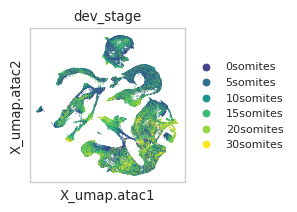

In [96]:
# UMAP (integrated_ATAC) colored with dev_stage
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.atac", color=["dev_stage"], palette=color_dict,
               legend_fontsize=8,save="_integrated_ATAC_dev_stage.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


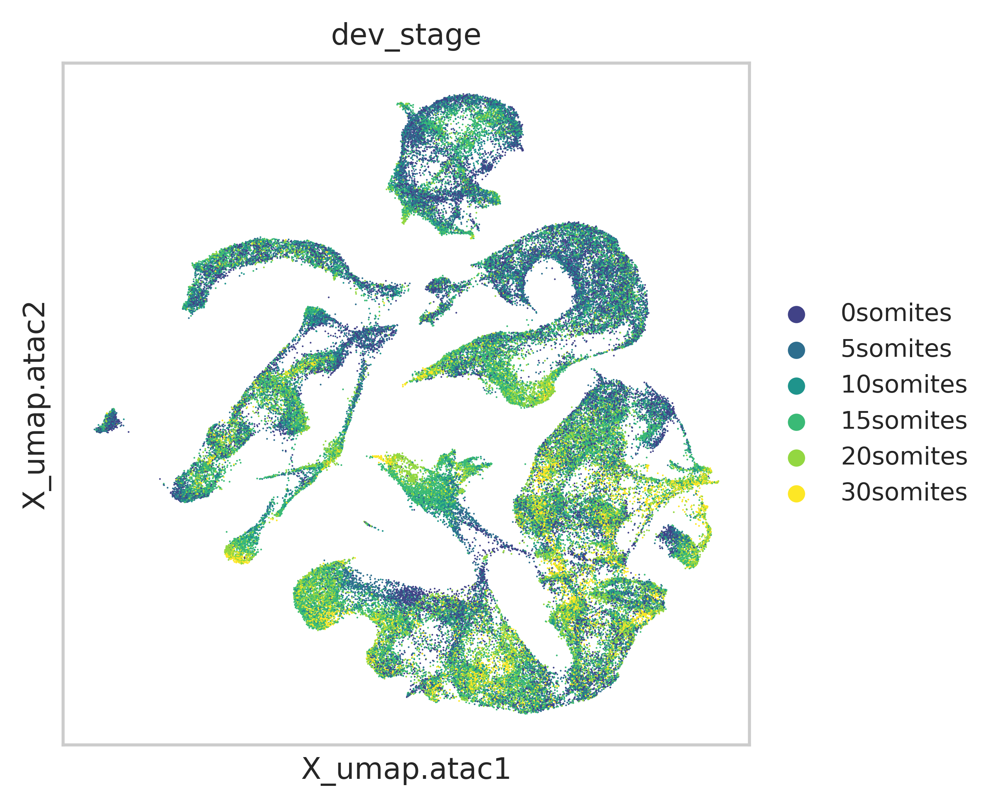

In [97]:
# UMAP (integrated_ATAC) colored with dev_stage
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.atac", color=["dev_stage"], palette=color_dict,
               legend_fontsize=8,save="_integrated_ATAC_dev_stage.png")

## RNA modality

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


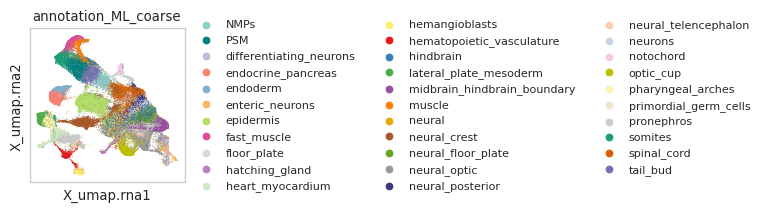

In [114]:
# UMAP (integrated_RNA) colored by the cell types (annotation_ML_coarse)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(multiome, basis="X_umap.rna",color=["annotation_ML_coarse"], palette=combined_palette,
               legend_fontsize=8,save="_integrated_RNA_celltypes.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


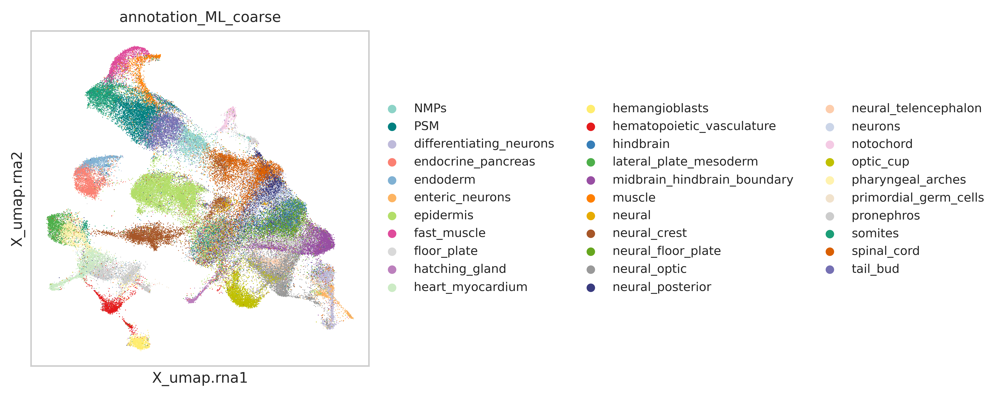

In [115]:
# UMAP (integrated_RNA) colored by the cell types (annotation_ML_coarse)
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(multiome, basis="X_umap.rna",color=["annotation_ML_coarse"], palette=combined_palette,
               legend_fontsize=8,save="_integrated_RNA_celltypes.png")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


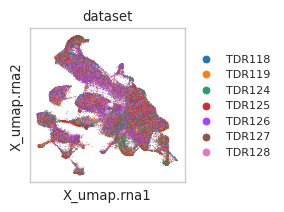

In [100]:
# UMAP (integrated_RNA) colored with batch
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.rna", color=["dataset"], sort_order=True,
               legend_fontsize=8,save="_integrated_rna_batch.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


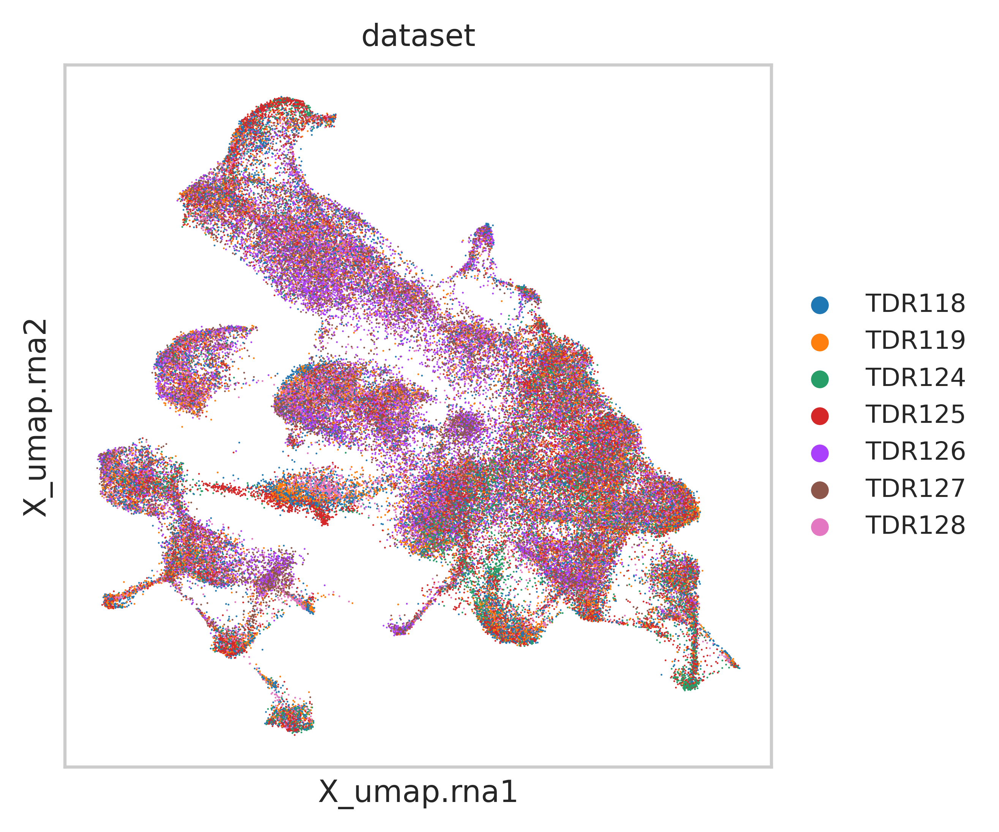

In [101]:
# UMAP (integrated_RNA) colored with batch
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.rna", color=["dataset"], sort_order=True,
               legend_fontsize=8,save="_integrated_rna_batch.png")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


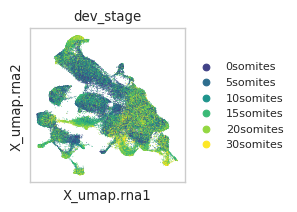

In [102]:
# UMAP (integrated_RNA) colored with "dev_stages"
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.rna", color=["dev_stage"], sort_order=True,
               legend_fontsize=8,save="_integrated_rna_dev_stages.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


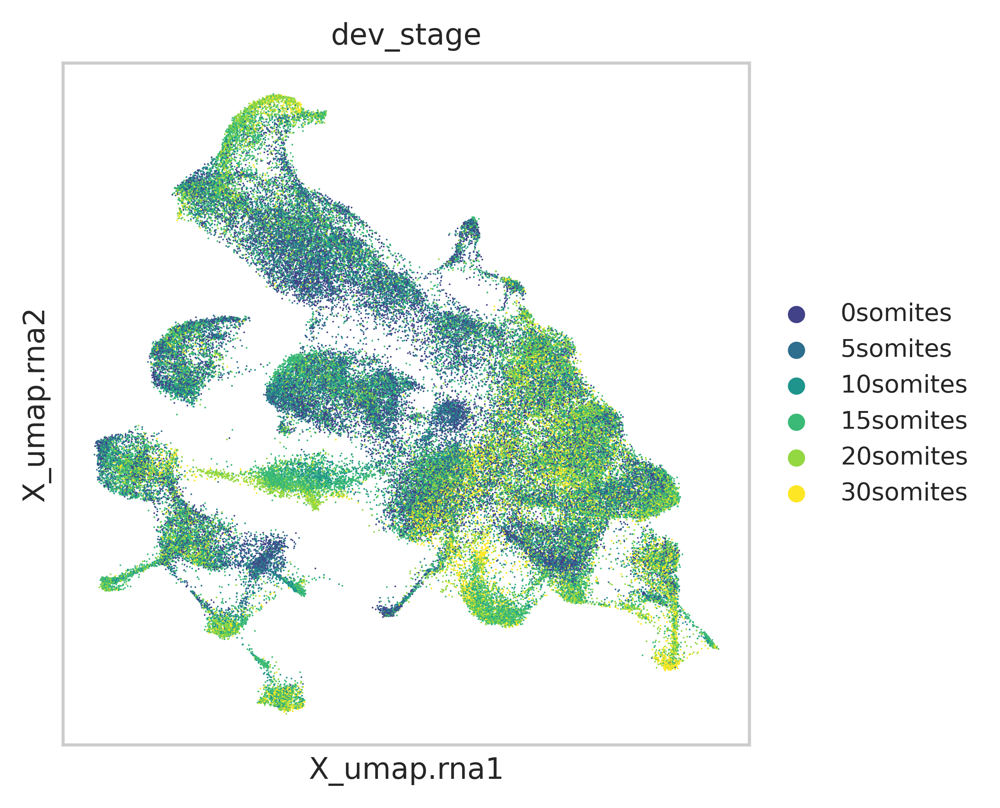

In [103]:
# UMAP (integrated_RNA) colored with "celltype annotation"
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(adata_shuffled, basis="X_umap.rna", color=["dev_stage"], sort_order=True,
               legend_fontsize=8,save="_integrated_rna_dev_stages.png")

# joint embedding (Weighted Nearest-Neighbors)

In [105]:
multiome

AnnData object with n_obs × n_vars = 94562 × 32057
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters', 'data_source', 'annotation_ML', 'scANVI_zscape', 'annotation_ML_coarse', 'dev_stage'
    var: 'features'
    uns: 'annotation_ML_colors', 'dataset_colors', 'global_annotation_colors', 'log1p', 'scANVI_zscape_colors', 'annotation_ML_coarse_colors'
    obsm: 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


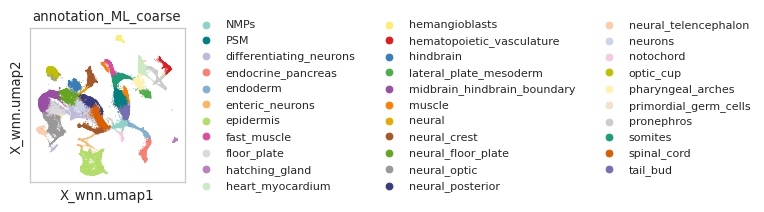

In [79]:
# UMAP (integrated_wnn) colored by the cell types (annotation_ML_coarse)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(multiome, basis="X_wnn.umap",color=["annotation_ML_coarse"], palette=combined_palette,
               legend_fontsize=8,save="_integrated_wnn_celltypes.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


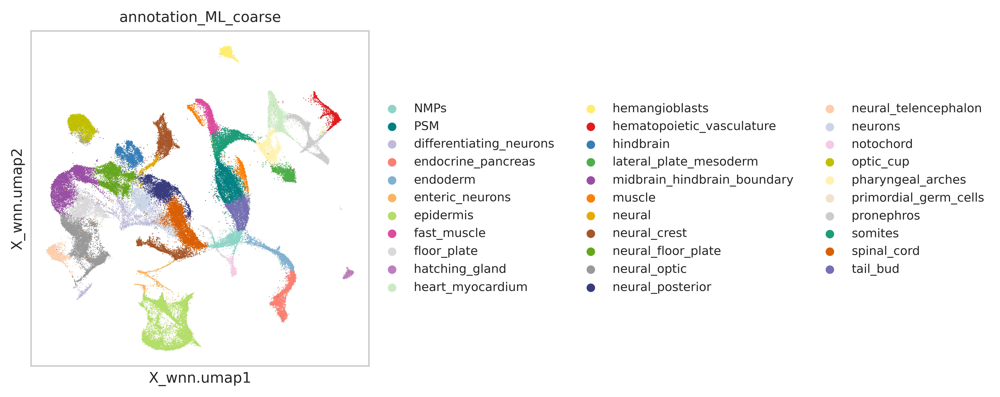

In [117]:
# UMAP (integrated_wnn) colored by the cell types (annotation_ML_coarse)
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(multiome, basis="X_wnn.umap",color=["annotation_ML_coarse"], palette=combined_palette,
               legend_fontsize=8,save="_integrated_wnn_celltypes.png")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


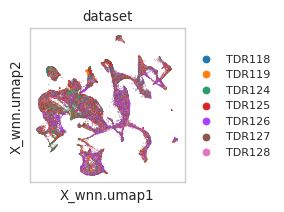

In [108]:
# UMAP (integrated_wnn) colored with batch
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(adata_shuffled, basis="X_wnn.umap", color=["dataset"], sort_order=True,
               legend_fontsize=8,save="_integrated_wnn_batch.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


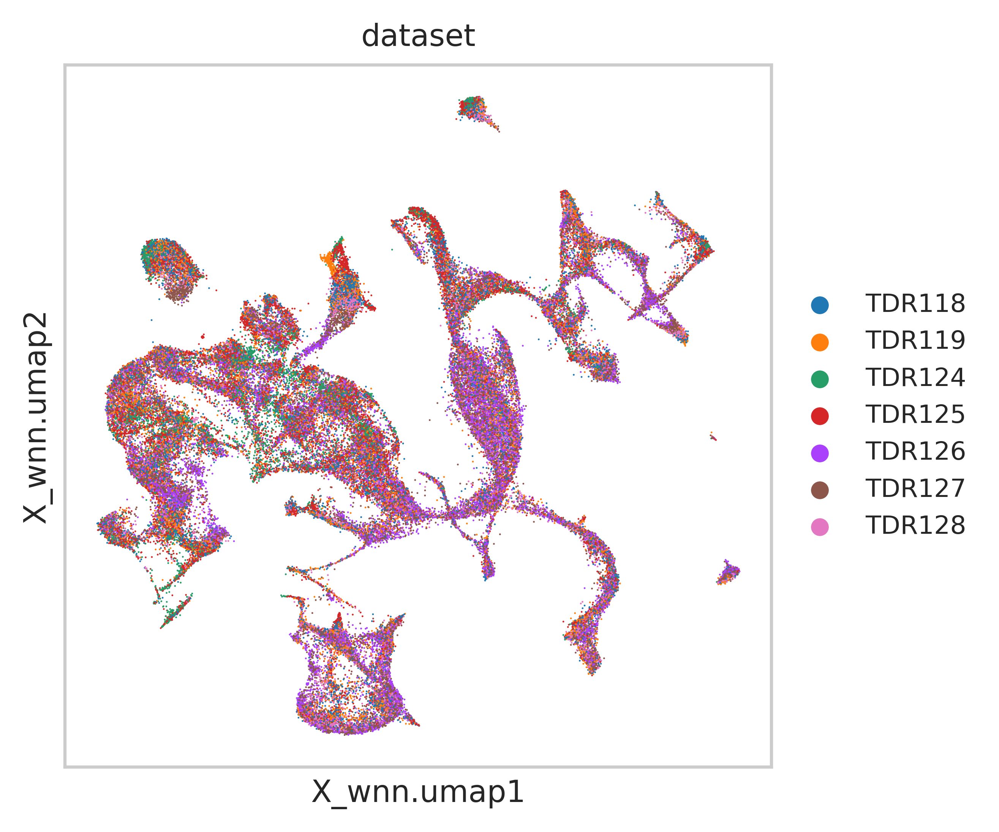

In [109]:
# UMAP (integrated_wnn) colored with batch
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(adata_shuffled, basis="X_wnn.umap", color=["dataset"], sort_order=True,
               legend_fontsize=8,save="_integrated_wnn_batch.png")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


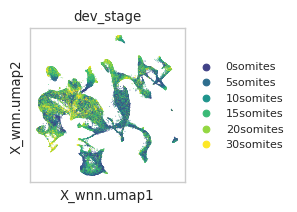

In [110]:
# UMAP (integrated_wnn) colored with "dev_stages"
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(adata_shuffled, basis="X_wnn.umap", color=["dev_stage"], sort_order=True,
               legend_fontsize=8,save="_integrated_wnn_dev_stages.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


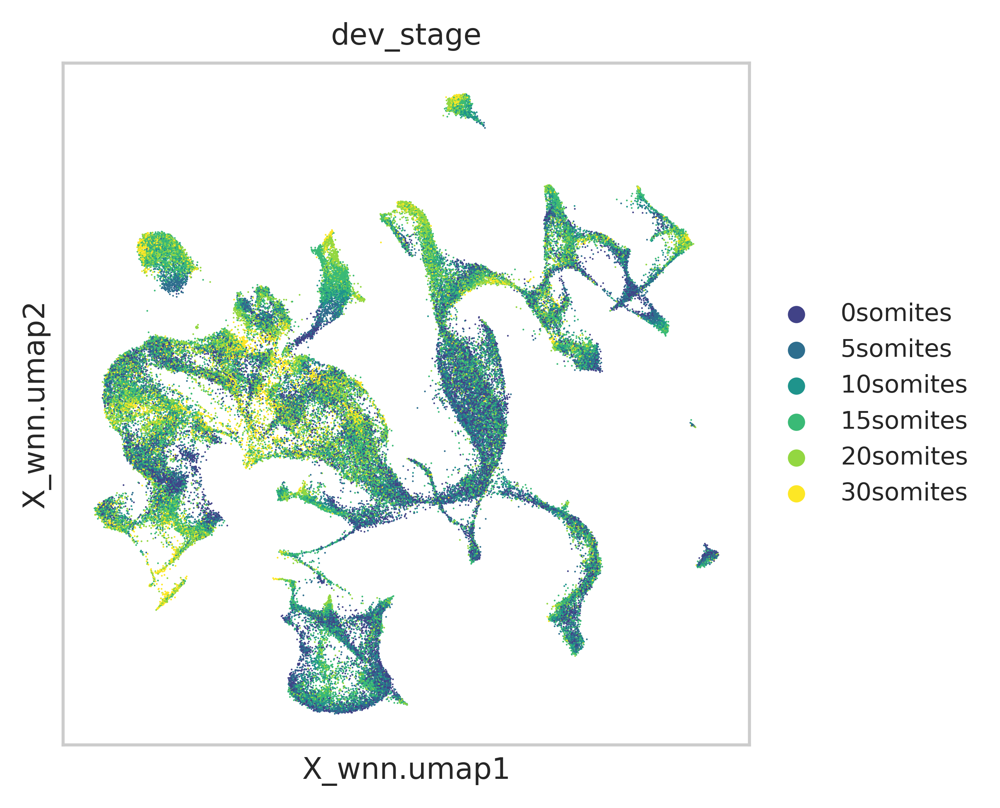

In [111]:
# UMAP (integrated_RNA) colored with "celltype annotation"
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.embedding(adata_shuffled, basis="X_wnn.umap", color=["dev_stage"], sort_order=True,
               legend_fontsize=8,save="_integrated_wnn_dev_stages.png")

In [119]:
# add the combined_palette to the adata object (multiome)
multiome.uns["annotation_ML_coarse_colors"] = combined_palette

In [120]:
multiome.write_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/integrated_RNA_ATAC_counts_RNA_master_filtered.h5ad")


# bar plots for the number of cells per timepoint/celltype

In [113]:
multiome.obs.dataset.value_counts()

dataset
TDR127    18963
TDR125    17130
TDR126    14970
TDR118    13568
TDR119    12413
TDR128    10990
TDR124     6528
Name: count, dtype: int64

In [ ]:
dict_dev_stages = {
    "TDR118":"15somites",
    "TDR119":"15somites",
    "TDR124":"30somites",
    "TDR125":"20somites",
    "TDR126":"0somites",
    "TDR127":"5somites",
    "TDR128":"10somites"
}

In [122]:
color_dict

{'0somites': array([0.255645, 0.260703, 0.528312, 1.      ]),
 '5somites': array([0.180629, 0.429975, 0.557282, 1.      ]),
 '10somites': array([0.123463, 0.581687, 0.547445, 1.      ]),
 '15somites': array([0.226397, 0.728888, 0.462789, 1.      ]),
 '20somites': array([0.575563, 0.844566, 0.256415, 1.      ]),
 '30somites': array([0.993248, 0.906157, 0.143936, 1.      ])}

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


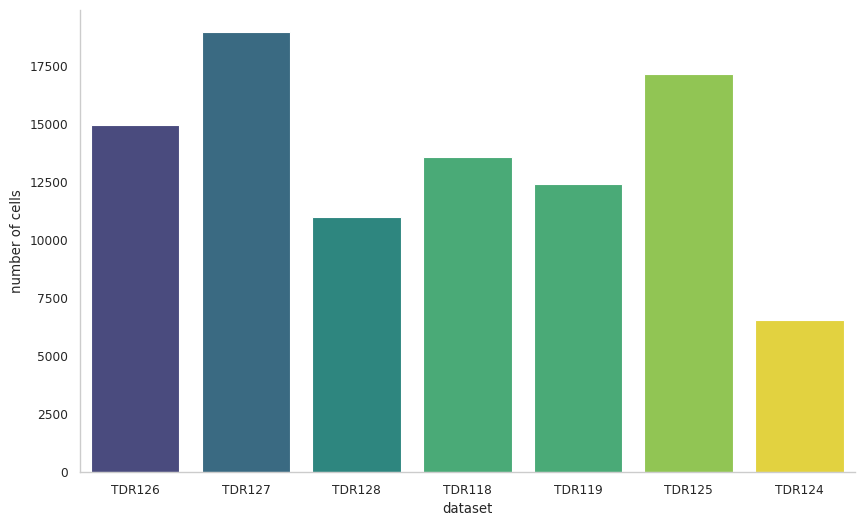

In [127]:
# Convert the Series to a DataFrame for seaborn
data_df = data.reset_index()
data_df.columns = ['Dataset', 'Count']

# Map the development stages to the dataset
data_df['Stage'] = data_df['Dataset'].map(dict_dev_stages)

# Ensure the dataset is in the desired order
data_df['Dataset'] = pd.Categorical(data_df['Dataset'], categories=[
    'TDR126', 'TDR127', 'TDR128', 'TDR118', 'TDR119', 'TDR125', 'TDR124'], ordered=True)

# Sort the DataFrame by the categorical order
data_df = data_df.sort_values('Dataset')

# Generate the color palette for the bar plot
palette = data_df['Stage'].map(color_dict).tolist()

# Plotting the bar plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x='Dataset', y='Count', data=data_df, palette=palette)

# Adding titles and labels
#plt.title('Dataset Value Counts by Development Stage')
plt.xlabel('dataset')
plt.ylabel('number of cells')

# Remove horizontal grid lines
plt.grid(False)
sns.despine()

# Display the plot
plt.xticks(rotation=0)

plt.savefig(figpath+"bar_plot_cell_numbers_datasets.png")
plt.savefig(figpath+"bar_plot_cell_numbers_datasets.pdf")

plt.show()


# Step 2. UMAPs from individual timepoints

In [8]:
dict_dev_stages = {
    "TDR118":"15somites",
    "TDR119":"15somites",
    "TDR124":"30somites",
    "TDR125":"20somites",
    "TDR126":"0somites",
    "TDR127":"5somites",
    "TDR128":"10somites"
}

In [9]:
# list of datasets (as they are saved in their filepaths
list_datasets = ["TDR126", "TDR127", "TDR128",
                 "TDR118reseq", "TDR119reseq",
                 "TDR125reseq", "TDR124reseq"]


<Figure size 1000x200 with 0 Axes>

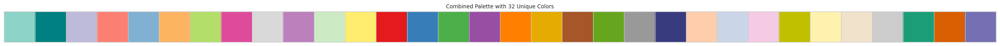

In [96]:
plt.figure(figsize=(10, 2))
sns.palplot(multiome.uns["annotation_ML_coarse_colors"])
plt.title("Combined Palette with 32 Unique Colors")
plt.show()

In [40]:
# test cell
data_path = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/"
dataset = "TDR126"
data = sc.read_h5ad(data_path + f"{dataset}/{dataset}_processed_RNA.h5ad")
data

AnnData object with n_obs × n_vars = 15036 × 32057
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'prediction.score.unassigned', 'prediction.score.Neural_Anterior', 'prediction.score.Lateral_Mesoderm', 'prediction.score.Neural_Crest', 'prediction.score.PSM', 'prediction.score.Neural_Posterior', 'prediction.score.Epidermal', 'prediction.score.Somites', 'prediction.score.NMPs', 'prediction.score.Endoderm', 'prediction.score.Muscle', 'prediction.score.Notochord', 'prediction.score.Differentiating_Neurons', 'prediction.score.Germline', 'prediction.score.max', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT.weight', 'peaks_merged.weight', 'nCount_Gene.Activity', 'nFeature_Gene.Activity'
    var: 'features'
    obsm: 'X_umap

In [118]:
list_datasets

['TDR126',
 'TDR127',
 'TDR128',
 'TDR118reseq',
 'TDR119reseq',
 'TDR125reseq',
 'TDR124reseq']

In [114]:
cell_type_color_dict = {
    'NMPs': '#8dd3c7',
    'PSM': '#008080',
    'differentiating_neurons': '#bebada',
    'endocrine_pancreas': '#fb8072',
    'endoderm': '#80b1d3',
    'enteric_neurons': '#fdb462',
    'epidermis': '#b3de69',
    'fast_muscle': '#df4b9b',
    'floor_plate': '#d9d9d9',
    'hatching_gland': '#bc80bd',
    'heart_myocardium': '#ccebc5',
    'hemangioblasts': '#ffed6f',
    'hematopoietic_vasculature': '#e41a1c',
    'hindbrain': '#377eb8',
    'lateral_plate_mesoderm': '#4daf4a',
    'midbrain_hindbrain_boundary': '#984ea3',
    'muscle': '#ff7f00',
    'neural': '#e6ab02',
    'neural_crest': '#a65628',
    'neural_floor_plate': '#66a61e',
    'neural_optic': '#999999',
    'neural_posterior': '#393b7f',
    'neural_telencephalon': '#fdcdac',
    'neurons': '#cbd5e8',
    'notochord': '#f4cae4',
    'optic_cup': '#c0c000',
    'pharyngeal_arches': '#fff2ae',
    'primordial_germ_cells': '#f1e2cc',
    'pronephros': '#cccccc',
    'somites': '#1b9e77',
    'spinal_cord': '#d95f02',
    'tail_bud': '#7570b3'
}


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


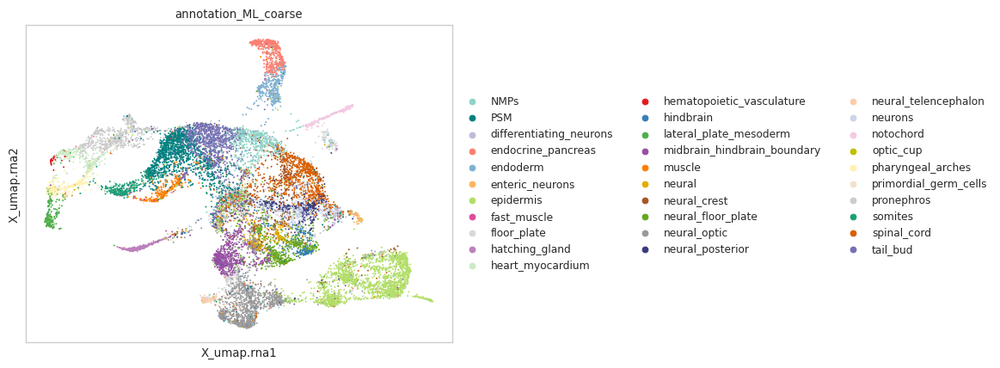

In [115]:
sc.pl.embedding(data, basis=key, color="annotation_ML_coarse", palette=cell_type_color_dict)

In [119]:
figpath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/zebrahub-multiome-analysis/figures/umaps_individual_datasets/"
os.makedirs(figpath, exist_ok=True)
sc.settings.figdir = figpath

In [126]:
list_datasets

['TDR126',
 'TDR127',
 'TDR128',
 'TDR118reseq',
 'TDR119reseq',
 'TDR125reseq',
 'TDR124reseq']

In [123]:
data_id

'TDR118'

/tmp/ipykernel_1624030/977968968.py:23: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna


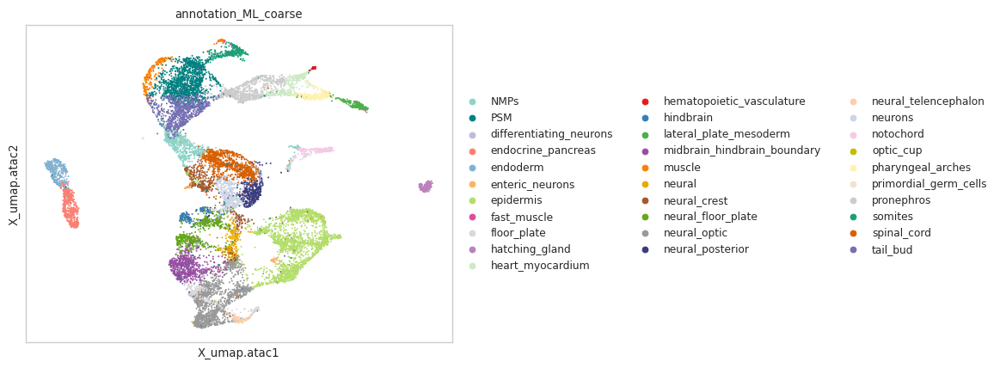

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


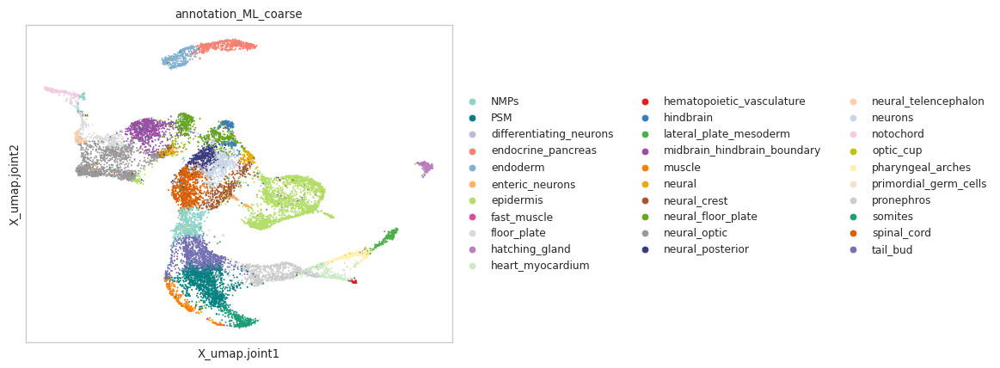

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


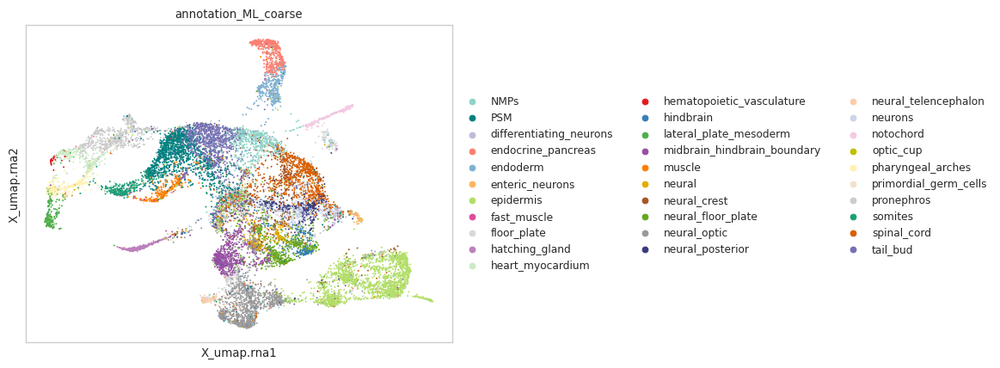

/tmp/ipykernel_1624030/977968968.py:23: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna


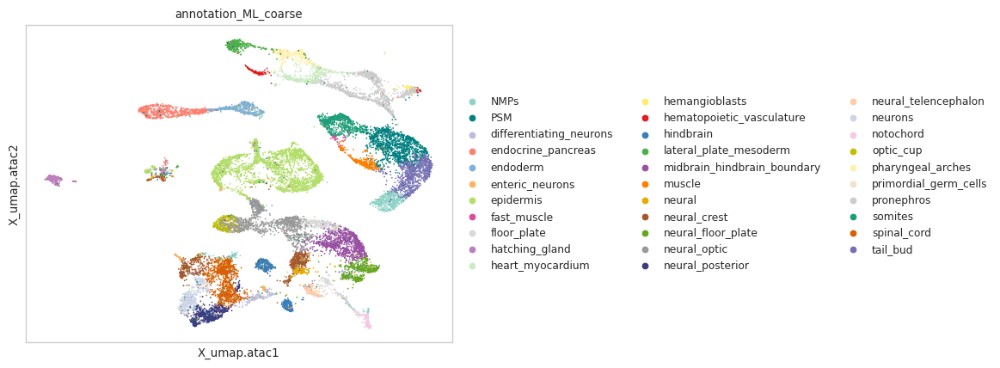

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


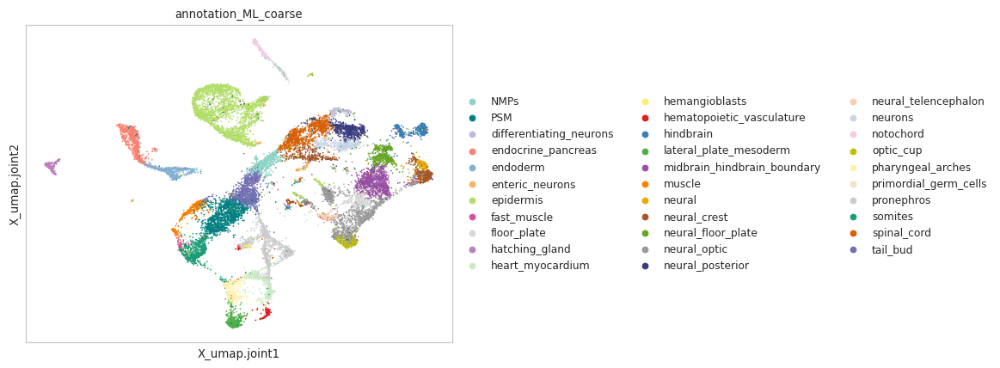

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


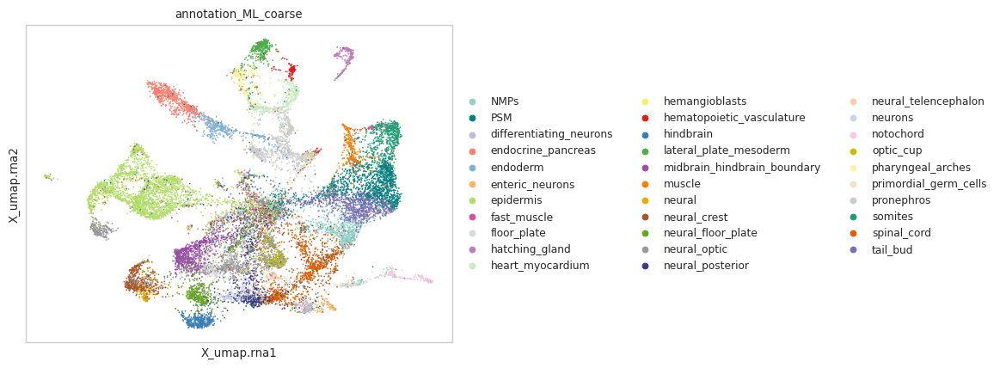

AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna


/tmp/ipykernel_1624030/977968968.py:23: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


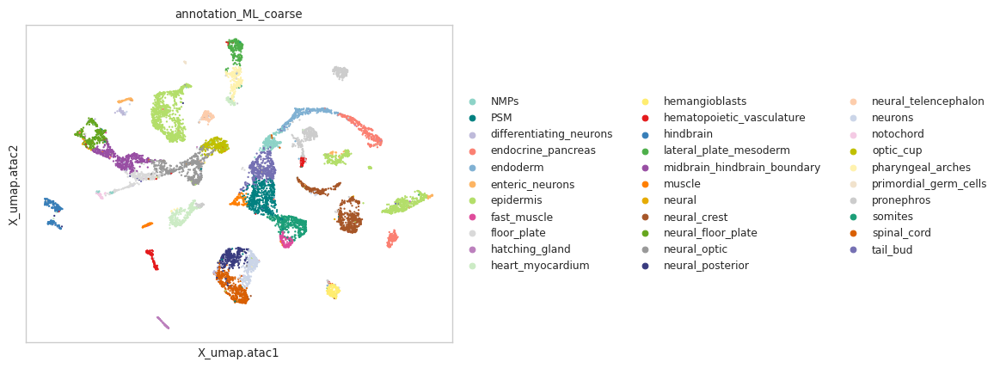

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


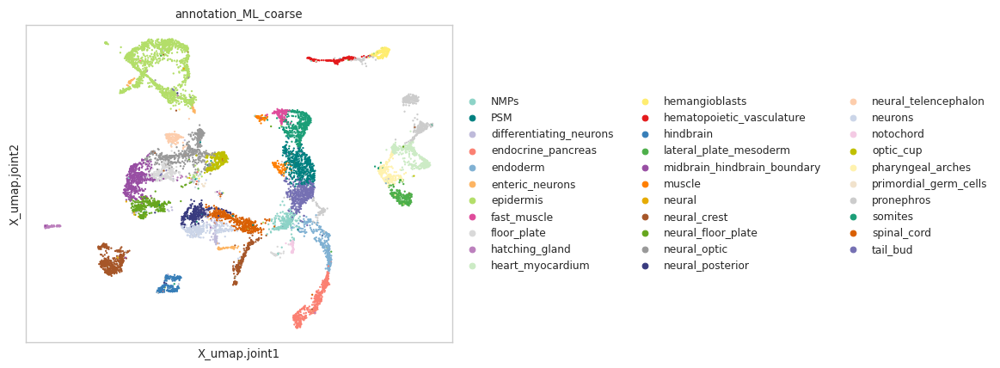

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


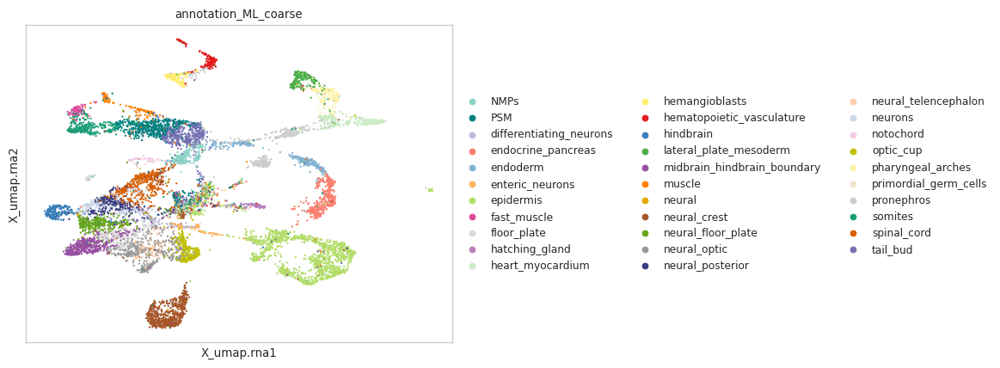

/tmp/ipykernel_1624030/977968968.py:23: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna


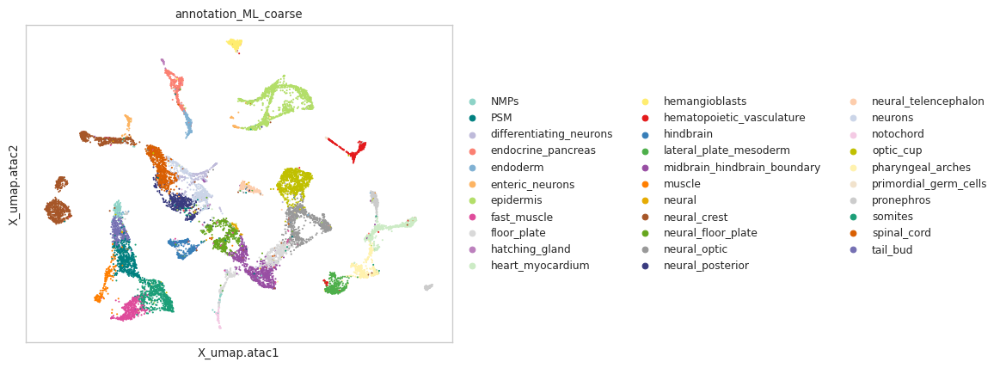

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


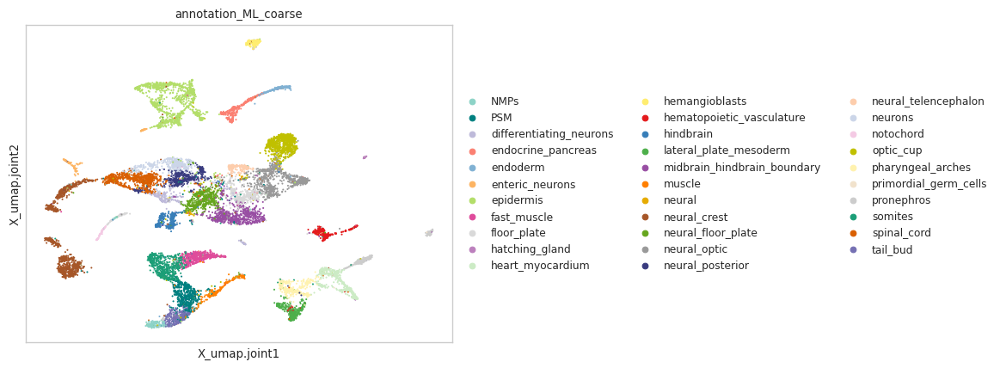

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


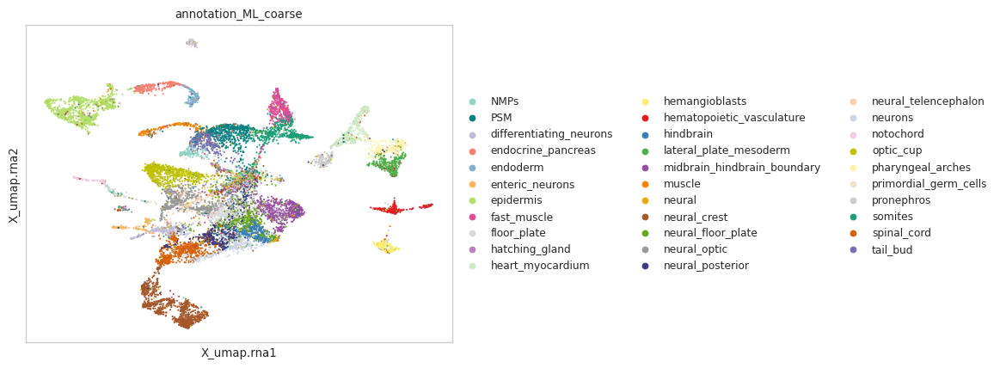

/tmp/ipykernel_1624030/977968968.py:23: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna


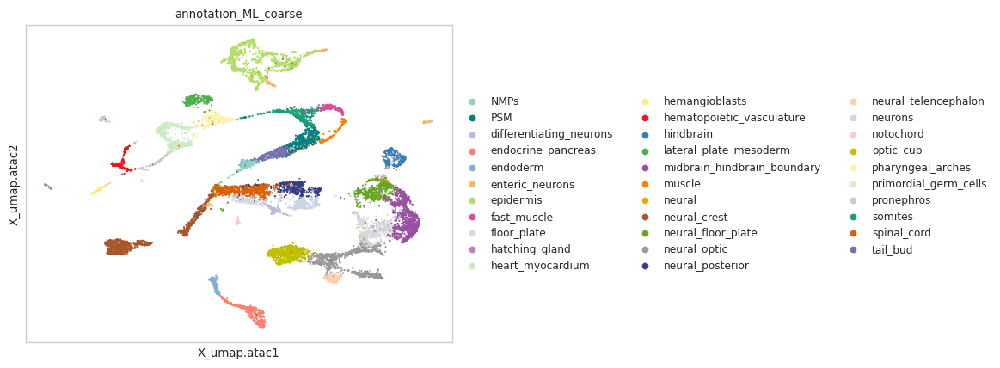

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


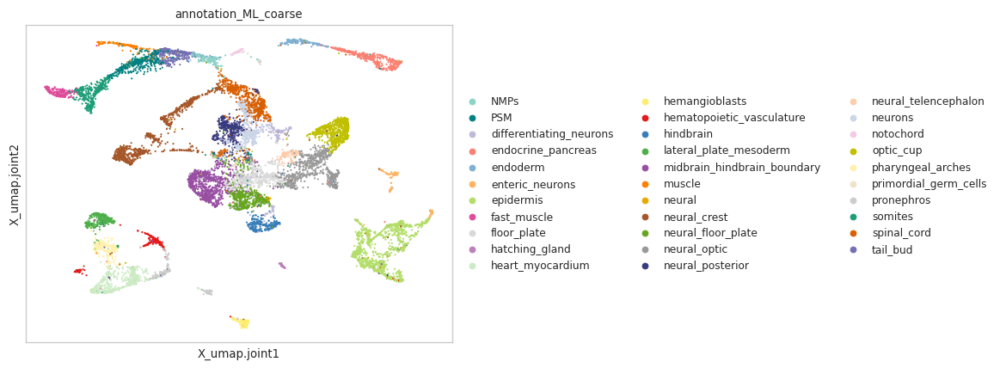

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


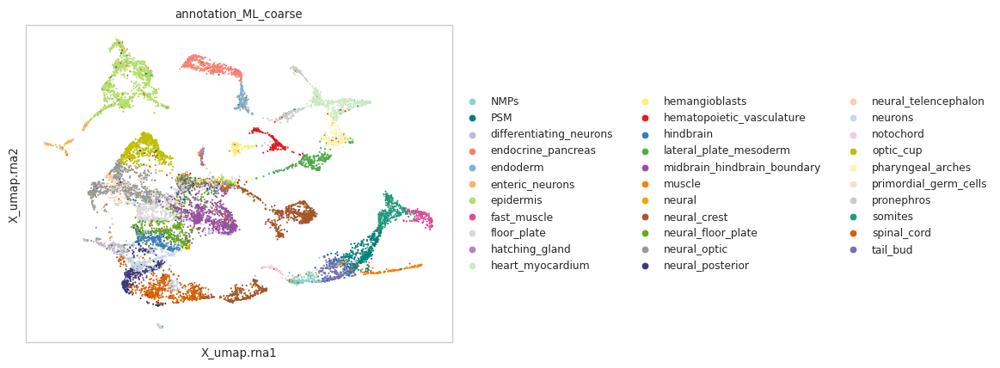

/tmp/ipykernel_1624030/977968968.py:23: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna


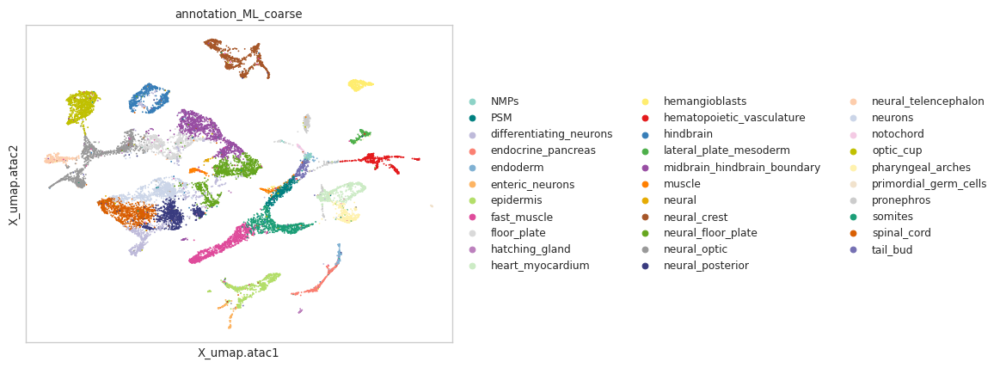

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


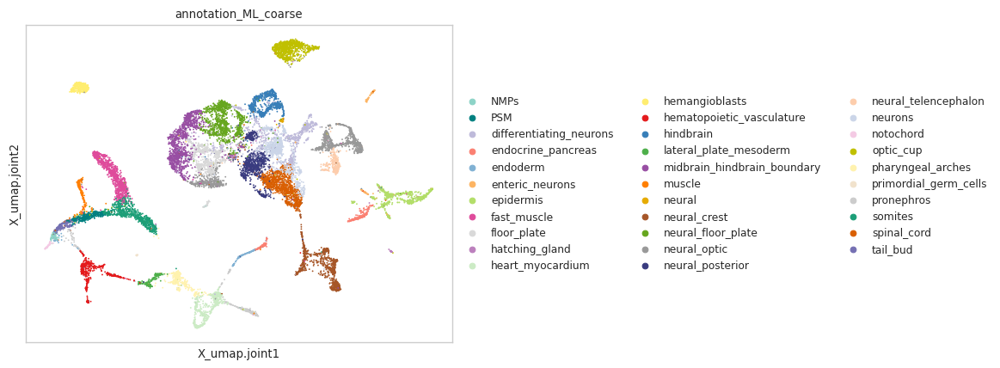

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


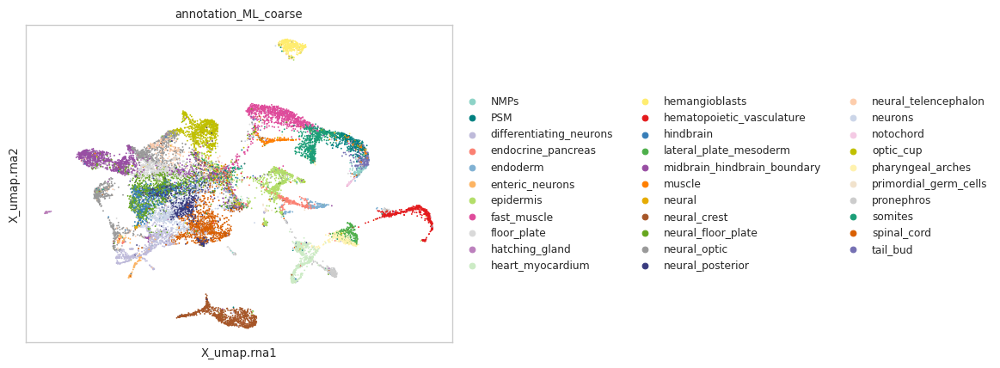

AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna


/tmp/ipykernel_1624030/977968968.py:23: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


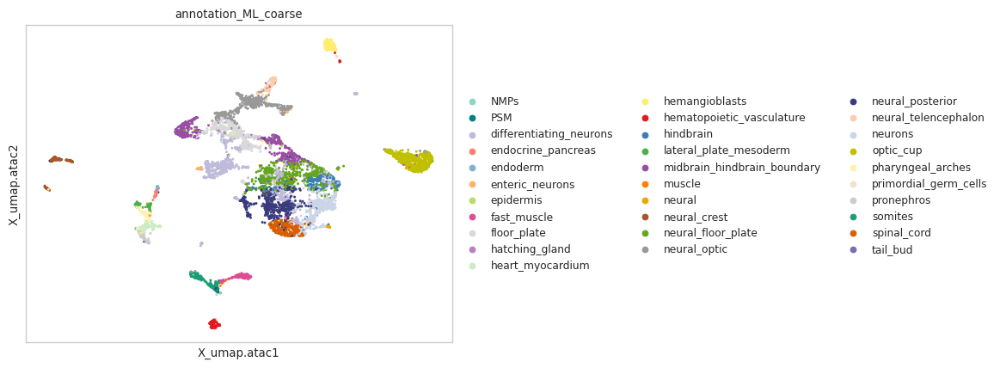

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


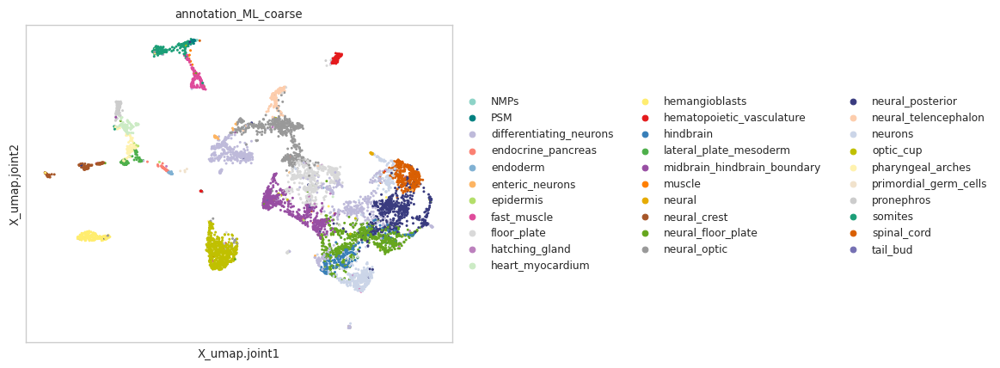

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


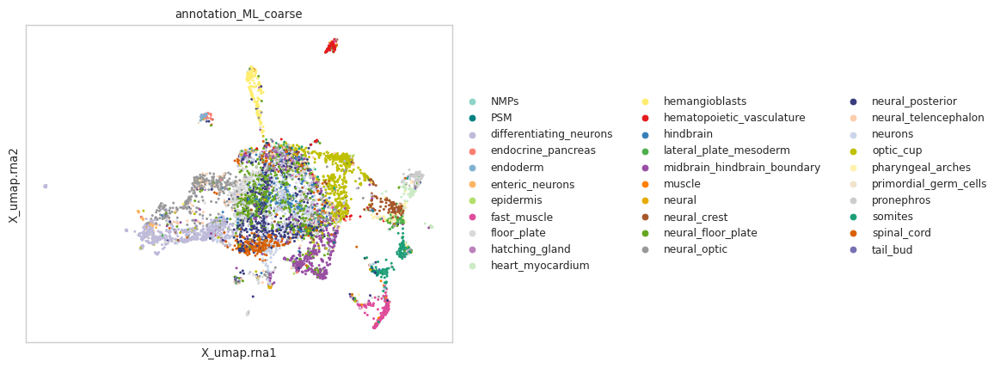

In [124]:
# define the master data filepath
data_path = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/"

for dataset in list_datasets:
    # strip off "reseq" for the data_id
    data_id = dataset.replace("reseq","")
    # import the dataset
    data = sc.read_h5ad(data_path + f"{dataset}/{data_id}_processed_RNA.h5ad")
    
    # transfer the annotations
    # subset the adata
    subset = multiome[multiome.obs["dataset"]==data_id]
    # correct indices by removing the appended '_X' or any such pattern
    subset.obs_names = subset.obs_names.str.replace(r'_[^_]*$', '', regex=True)
    
    # create a mapping from the subset to the original data based on index
    annotation_mapping = subset.obs['annotation_ML_coarse']
    
    # map the annotations to the 'data' object using the corrected indices
    # first, subset for the shared cell_ids
    data = data[data.obs_names.isin(subset.obs_names)]
    # this step assumes that indices in 'data' after modification are a subset of those in 'subset'
    data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
    
    # check the embeddings
    print(data.obsm)
    # generate the UMAPs for each modality (note that we have to be careful with the color dict)
    for key in data.obsm_keys():
        sc.pl.embedding(data, basis=key, color="annotation_ML_coarse", palette=cell_type_color_dict,
                       save=f"_{data_id}_ML_coarse.png")
        
        
    

### plot the alignedUMAPs

In [131]:
aligned_umap_coords = pd.read_csv("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/aligned_umap_coords_all_timepoints.csv", index_col=0)
aligned_umap_coords

aligned_umap_coords.set_index("cell_id", inplace=True)
aligned_umap_coords

,UMAP_1,UMAP_2,timepoint,cell_type
cell_id,,,,
AAACAGCCAAACGGGC-1_5,4.953778,2.442441,0somites,neural_crest
AAACAGCCAACACTTG-1_5,-5.233437,1.180985,0somites,spinal_cord
AAACAGCCACAATGCC-1_5,-1.298670,-6.882564,0somites,PSM
AAACAGCCACCTGGTG-1_5,-3.803171,7.873410,0somites,neural_posterior
AAACAGCCAGTTATCG-1_5,-4.022766,-0.913390,0somites,NMPs
...,...,...,...,...
TTTGTGGCACATTAAC-1_3,-4.950180,9.759020,30somites,neural_crest
TTTGTGGCATAGCGGA-1_3,-4.827744,2.100823,30somites,fast_muscle
TTTGTGTTCATCAGTA-1_3,-5.124492,-8.927271,30somites,spinal_cord


In [132]:
aligned_umap_coords.timepoint.unique()

array(['0somites', '5somites', '10somites', '15somites', '15somites-2',
       '20somites', '30somites'], dtype=object)

In [129]:
dict_timepoints = {'TDR118': '15somites',
 'TDR119': '15somites-2',
 'TDR124': '30somites',
 'TDR125': '20somites',
 'TDR126': '0somites',
 'TDR127': '5somites',
 'TDR128': '10somites'}

/tmp/ipykernel_1624030/4093685345.py:21: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna, X_aligned_umap


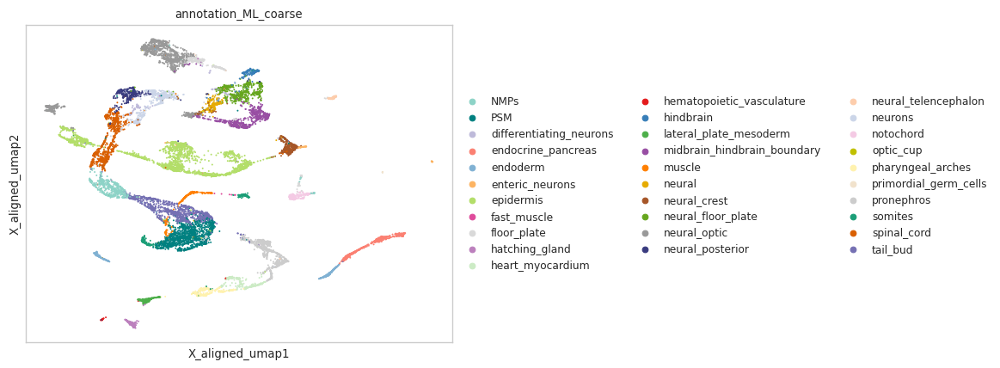

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


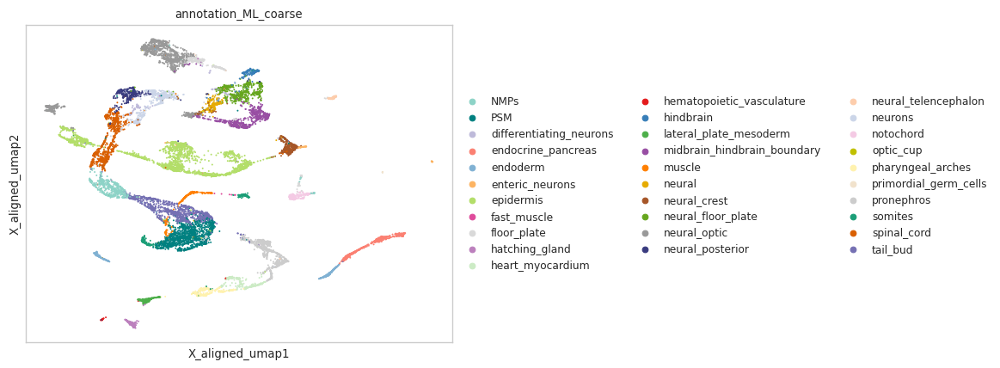

/tmp/ipykernel_1624030/4093685345.py:21: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna, X_aligned_umap


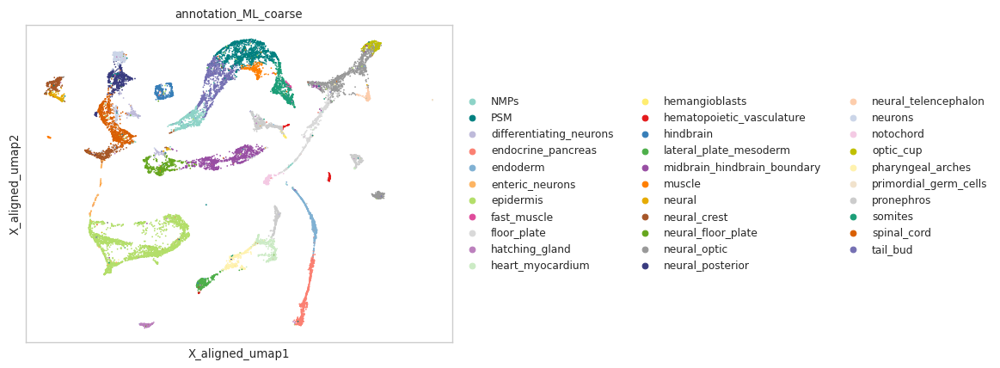

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


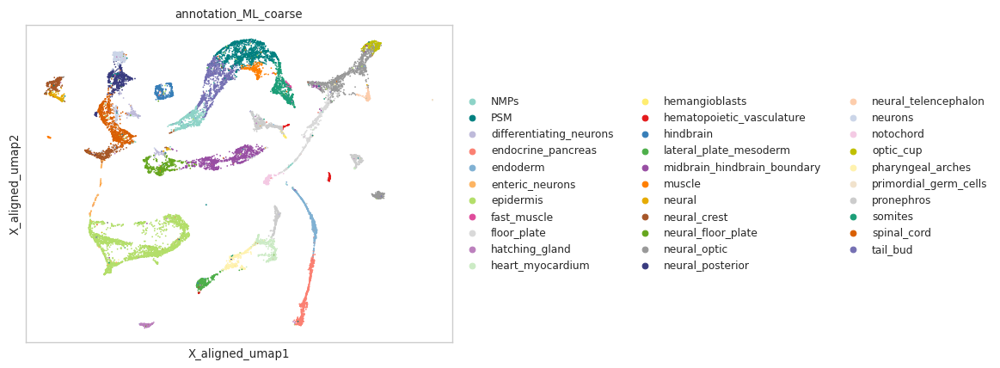

AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna, X_aligned_umap


/tmp/ipykernel_1624030/4093685345.py:21: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


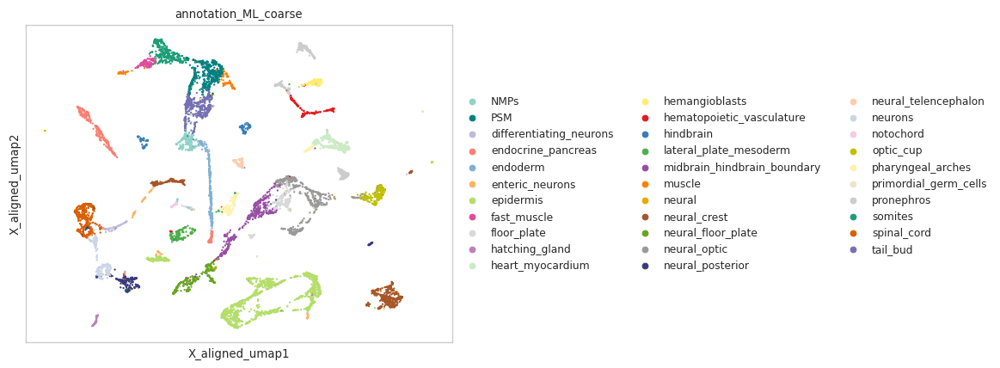

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


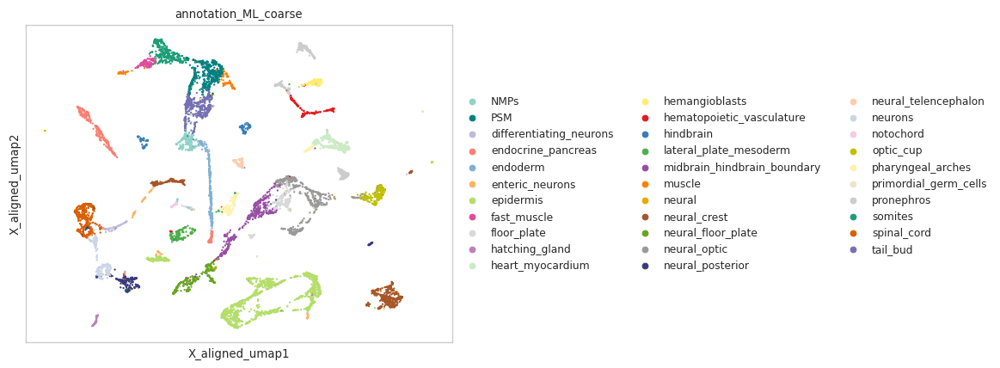

/tmp/ipykernel_1624030/4093685345.py:21: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna, X_aligned_umap


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


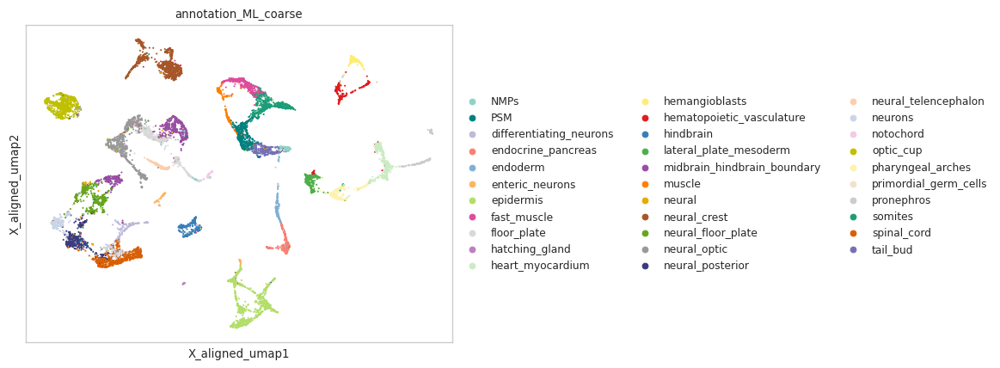

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


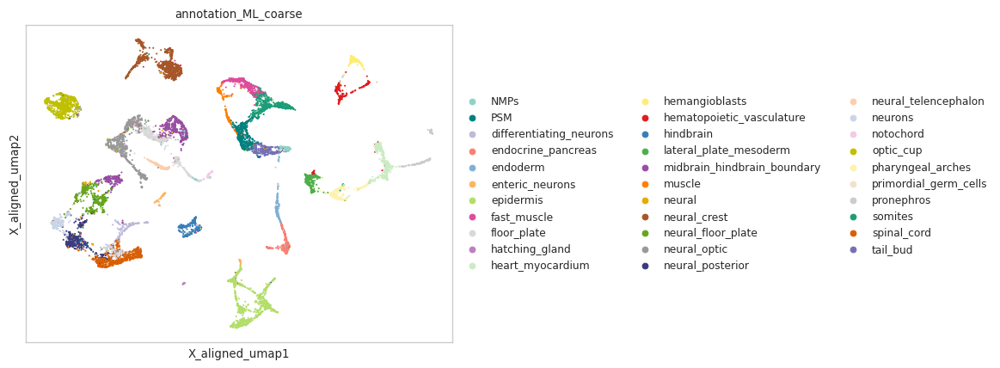

/tmp/ipykernel_1624030/4093685345.py:21: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna, X_aligned_umap


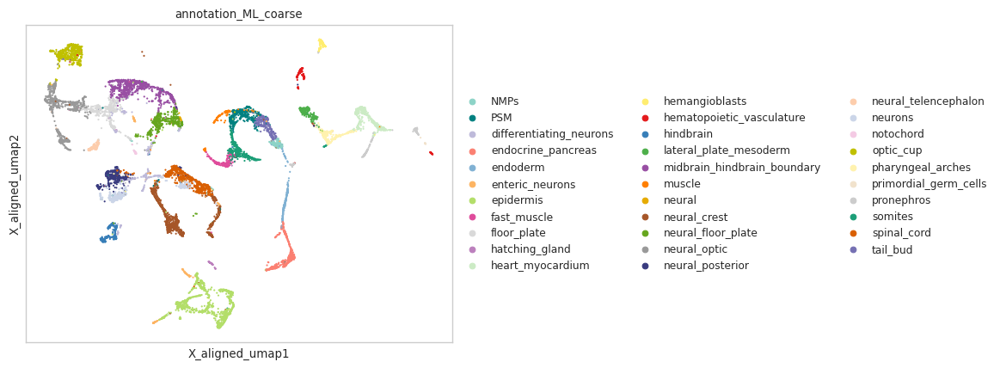

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


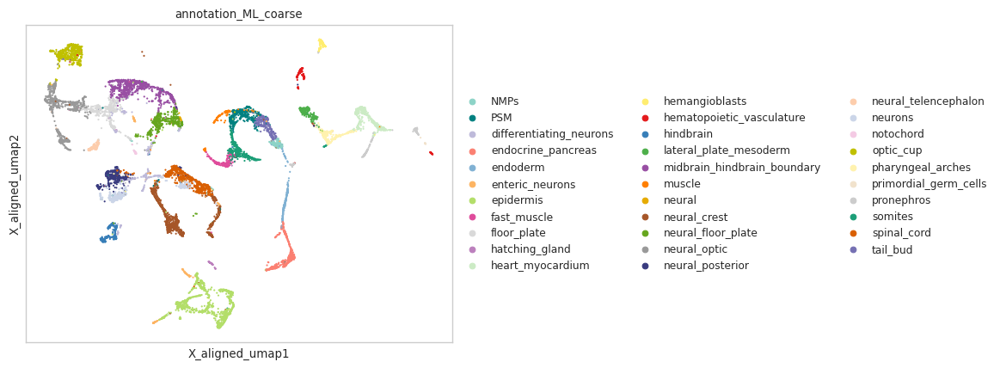

/tmp/ipykernel_1624030/4093685345.py:21: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna, X_aligned_umap


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


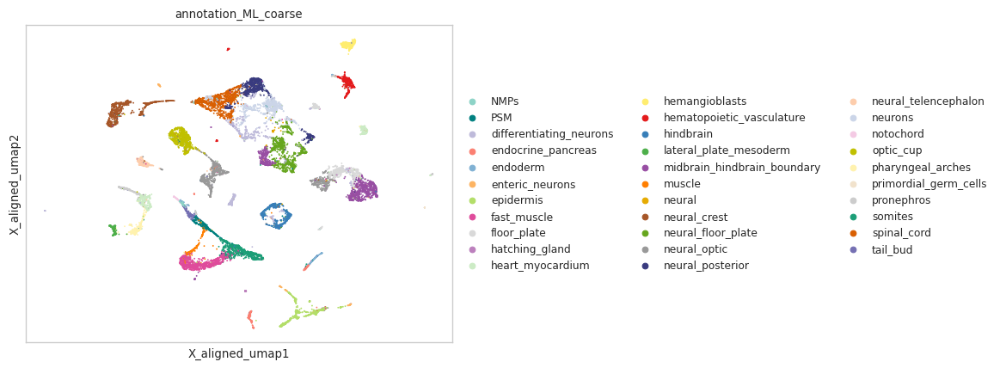

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


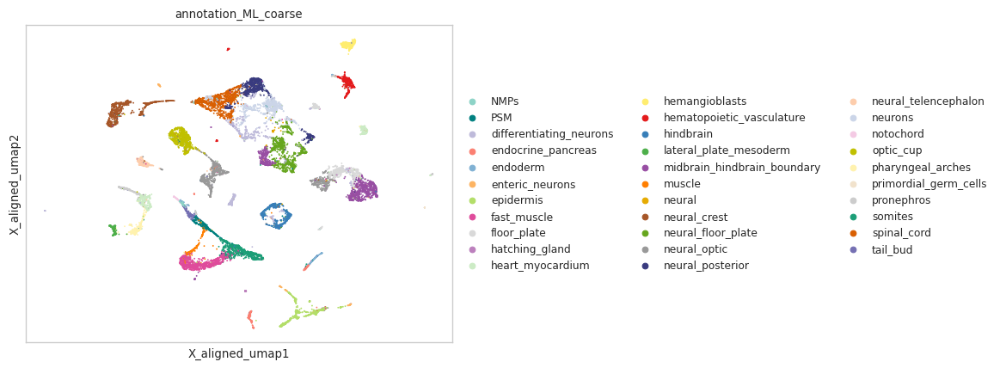

AxisArrays with keys: X_umap.atac, X_umap.joint, X_umap.rna, X_aligned_umap


/tmp/ipykernel_1624030/4093685345.py:21: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


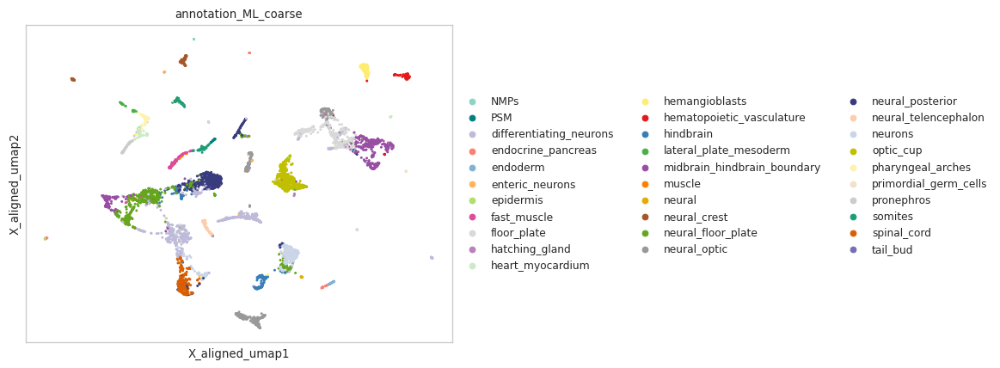

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


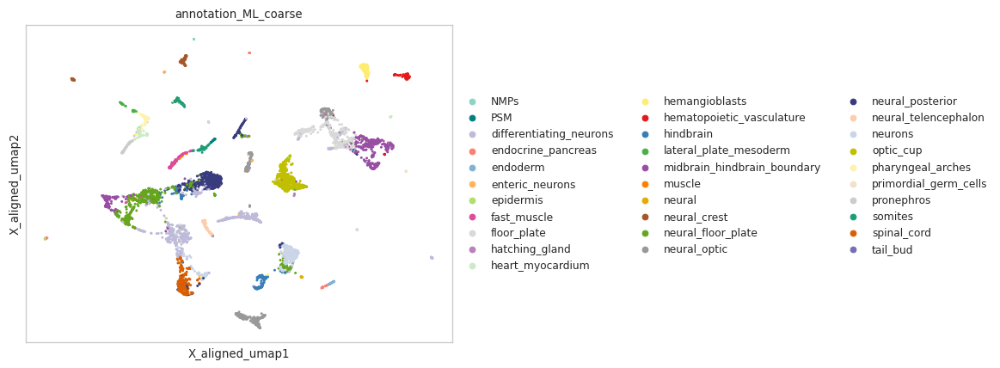

In [137]:
# go through each dataset, and generate the UMAP by subsetting the aligned_umap_coords by the timepoint
for dataset in list_datasets:
    # strip off "reseq" for the data_id
    data_id = dataset.replace("reseq","")
    # import the dataset
    data = sc.read_h5ad(data_path + f"{dataset}/{data_id}_processed_RNA.h5ad")
    
    # transfer the annotations
    # subset the adata
    subset = multiome[multiome.obs["dataset"]==data_id]
    # correct indices by removing the appended '_X' or any such pattern
    subset.obs_names = subset.obs_names.str.replace(r'_[^_]*$', '', regex=True)
    
    # create a mapping from the subset to the original data based on index
    annotation_mapping = subset.obs['annotation_ML_coarse']
    
    # map the annotations to the 'data' object using the corrected indices
    # first, subset for the shared cell_ids
    data = data[data.obs_names.isin(subset.obs_names)]
    # this step assumes that indices in 'data' after modification are a subset of those in 'subset'
    data.obs['annotation_ML_coarse'] = data.obs_names.map(annotation_mapping)
    
    # subset the umap_coords
    time_key = data_id
    time_value = dict_timepoints[data_id]
    
    umap_coords = aligned_umap_coords[aligned_umap_coords.timepoint==time_value]
    data.obsm["X_aligned_umap"] = umap_coords[["UMAP_1","UMAP_2"]].values
    
    # check the embeddings
    print(data.obsm)
    # generate the UMAPs for each modality (note that we have to be careful with the color dict)
    # for key in data.obsm_keys():
    #     sc.pl.embedding(data, basis=key, color="annotation_ML_coarse", palette=cell_type_color_dict,
    #                    save=f"_{data_id}_ML_coarse.png")
    sc.pl.embedding(data, basis="X_aligned_umap", color="annotation_ML_coarse", palette=cell_type_color_dict,
                       save=f"_{data_id}_ML_coarse_aligned.pdf")
    sc.pl.embedding(data, basis="X_aligned_umap", color="annotation_ML_coarse", palette=cell_type_color_dict,
                       save=f"_{data_id}_ML_coarse_aligned.png")
        

In [133]:
time_value = "15somites-2"

umap_coords = aligned_umap_coords[aligned_umap_coords.timepoint==time_value]
umap_coords

,UMAP_1,UMAP_2,timepoint,cell_type
cell_id,,,,
AAACAGCCACTCGCTC-1_2,11.971120,3.779146,15somites-2,heart_myocardium
AAACAGCCAGTTATGT-1_2,6.650406,-7.978453,15somites-2,endocrine_pancreas
AAACAGCCATCTAGCA-1_2,3.909117,0.107161,15somites-2,somites
AAACAGCCATTCCTCG-1_2,1.327581,-8.221525,15somites-2,hatching_gland
AAACATGCAAGGTCCT-1_2,0.867677,0.723966,15somites-2,muscle
...,...,...,...,...
TTTGTTGGTGCATTAG-1_2,-3.516203,-1.424994,15somites-2,differentiating_neurons
TTTGTTGGTTAAGCGC-1_2,2.435675,-12.279971,15somites-2,epidermis
TTTGTTGGTTAGCATG-1_2,-7.728322,8.632297,15somites-2,optic_cup


In [136]:
umap_coords[["UMAP_1","UMAP_2"]].values

array([[11.97112   ,  3.779146  ],
       [ 6.650406  , -7.9784527 ],
       [ 3.9091175 ,  0.10716122],
       ...,
       [-7.728322  ,  8.6322975 ],
       [ 3.2263103 ,  0.3468895 ],
       [ 1.5823762 , -3.02768   ]])

### marker gene expression (tissue-level)

- last updated: 07/09/2024

The goal is to denote that the marker gene expression highlights the tissue-level annotation.
So, we will show the "averaged" expression of a set of marker genes for tissues (endoderm, neuro-ectoderm, mesoderm, and hematopoetic vasculature)


In [13]:
list_tissues_markers = [markers_endo, markers_meso, markers_neuro, markers_hemato]

for index, markers in enumerate(list_tissues_markers):
    print(index, markers)

0 ['fgfrl1b', 'col2a1a', 'ptprfa', 'emid1', 'nr5a2', 'ism2a', 'pawr', 'mmp15b', 'foxa3', 'onecut1']
1 ['msgn1', 'meox1', 'tbx6', 'tbxta', 'fgf8a', 'her1']
2 ['pax7a', 'pax6a', 'pax6b', 'col18a1a', 'en2b', 'znf536', 'gpm6aa', 'gli3', 'chl1a']
3 ['lmo2', 'etv2', 'tal1', 'sox17']


['fgfrl1b', 'col2a1a', 'ptprfa', 'emid1', 'nr5a2', 'ism2a', 'pawr', 'mmp15b', 'foxa3', 'onecut1']


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


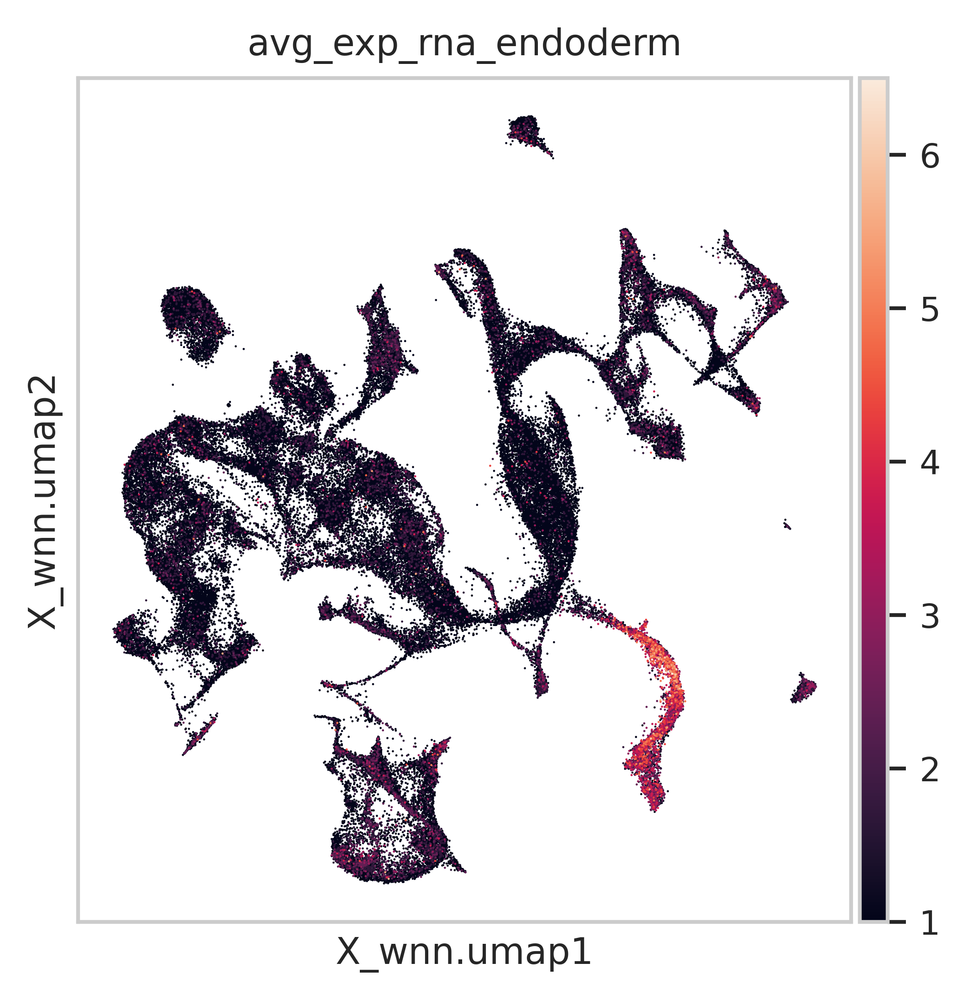

['msgn1', 'meox1', 'tbx6', 'tbxta', 'fgf8a', 'her1']


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


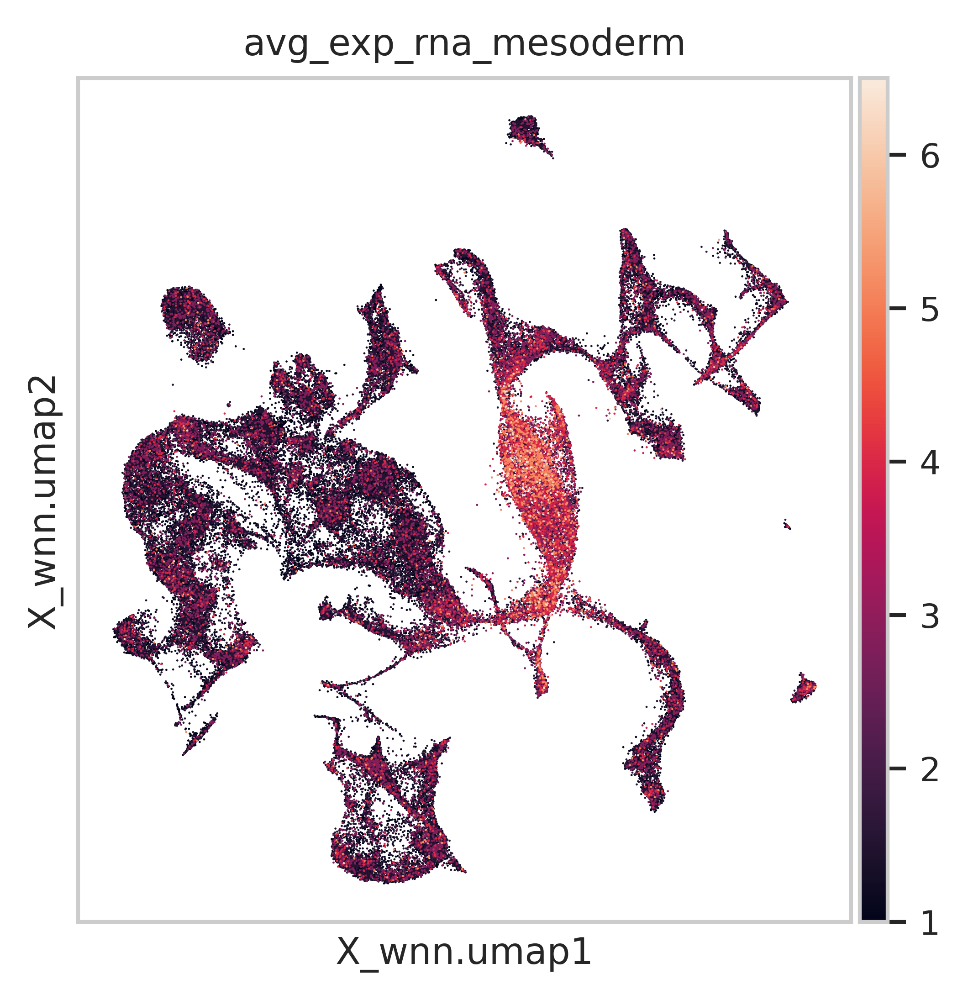

['pax7a', 'pax6a', 'pax6b', 'col18a1a', 'en2b', 'znf536', 'gpm6aa', 'gli3', 'chl1a']


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


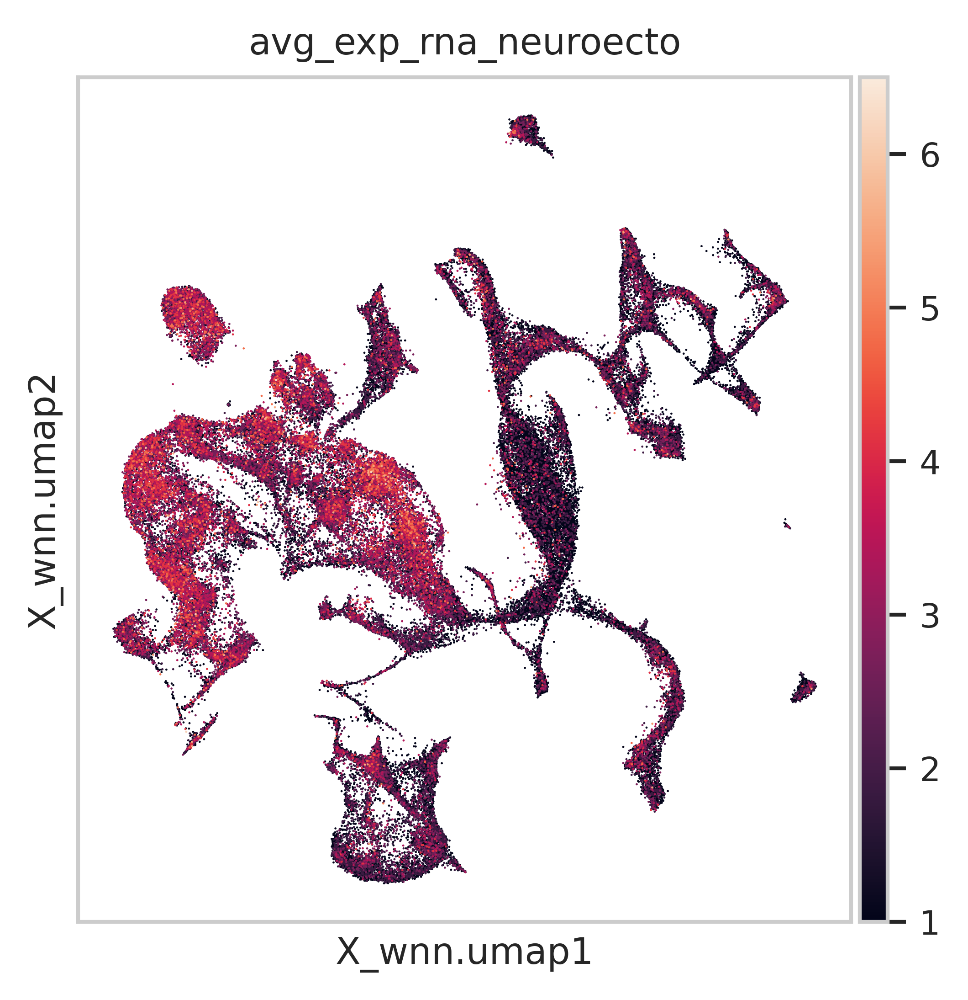

['lmo2', 'etv2', 'tal1', 'sox17']


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


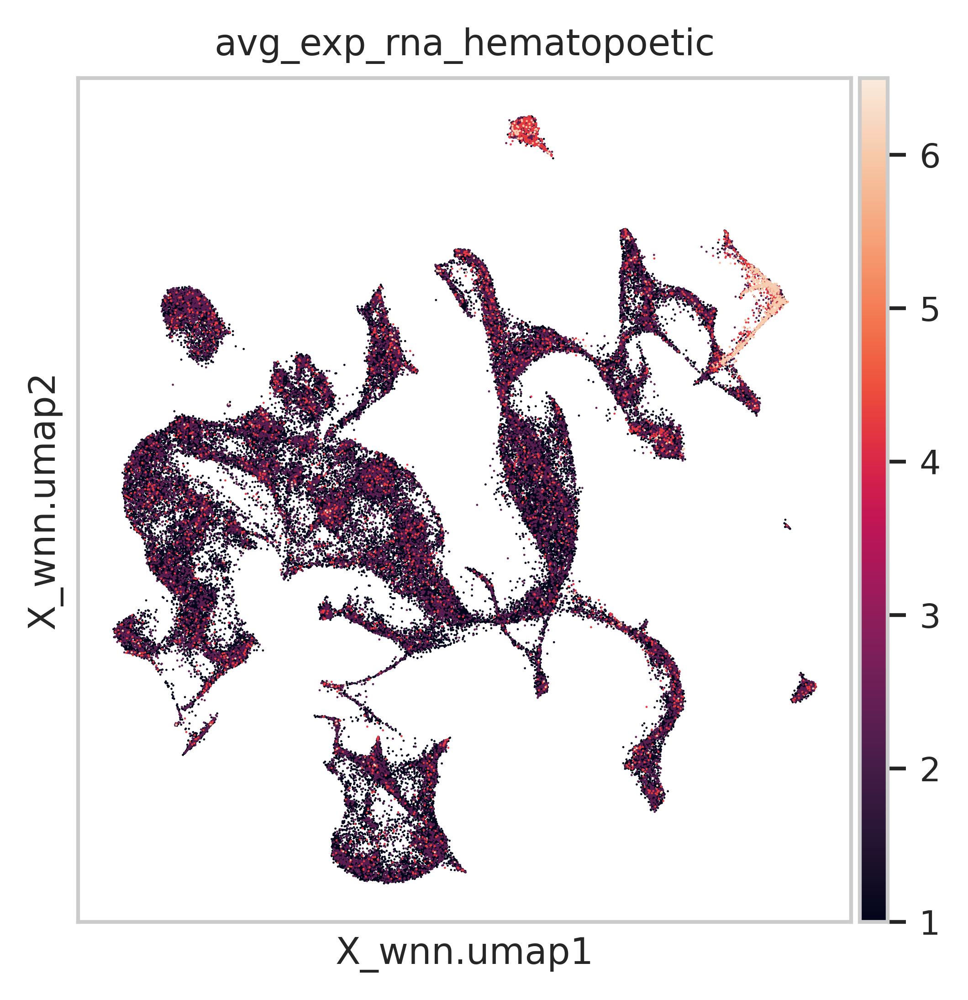

In [170]:
list_tissues_markers = [markers_endo, markers_meso, markers_neuro, markers_hemato]
list_tissues_markers

list_tissues = ["endoderm", "mesoderm", "neuroecto", "hematopoetic"]

for index, tissue_markers in enumerate(list_tissues_markers):
    print(tissue_markers)
    # subset for the list of marker genes
    adata_sub = multiome[:,multiome.var_names.isin(tissue_markers)]

    adata_sub.X = adata_sub.layers["counts"].copy()

    sc.pp.normalize_total(adata_sub, target_sum=1e4)
    sc.pp.log1p(adata_sub)
    
    # add the obs field to the main object (multiome)
    tissue = list_tissues[index]
    multiome.obs[f"avg_exp_rna_{tissue}"] = np.mean(adata_sub.X.todense(),axis=1)
    with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
        sc.pl.embedding(multiome, basis="X_wnn.umap", color=f"avg_exp_rna_{tissue}", save=f"_{tissue}_markers_rna.png", vmin=1, vmax=6.5)

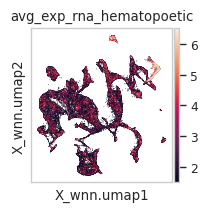

In [172]:
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(multiome, basis="X_wnn.umap", color=f"avg_exp_rna_{tissue}", save=f"_{tissue}_markers_rna.pdf", vmin=1.5, vmax=6.5)

### Gene.Activity object 

In [14]:
# import the multiome object where the adata.X contains the "gene.activity" - aggregated fragment counts from the scATAC-seq
multiome_ga = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/integrated_RNA_ATAC_counts_gene_activity_raw_counts_master_filtered.h5ad")
multiome_ga

AnnData object with n_obs × n_vars = 94562 × 25032
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters'
    var: 'features'
    obsm: 'X_umap', 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'

In [15]:
# log-normalize the "counts"
sc.pp.normalize_total(multiome_ga, target_sum=1e4)
sc.pp.log1p(multiome_ga)

['fgfrl1b', 'col2a1a', 'ptprfa', 'emid1', 'nr5a2', 'ism2a', 'pawr', 'mmp15b', 'foxa3', 'onecut1']


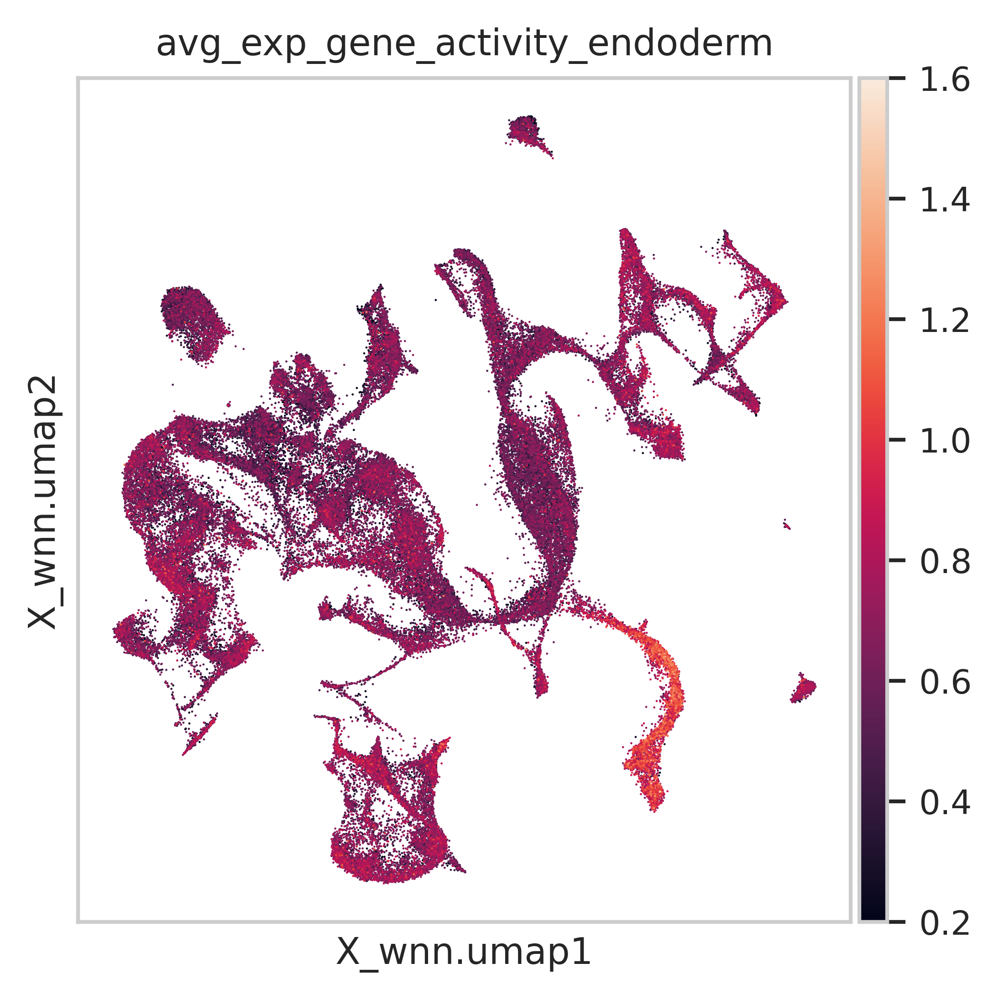

['msgn1', 'meox1', 'tbx6', 'tbxta', 'fgf8a', 'her1']


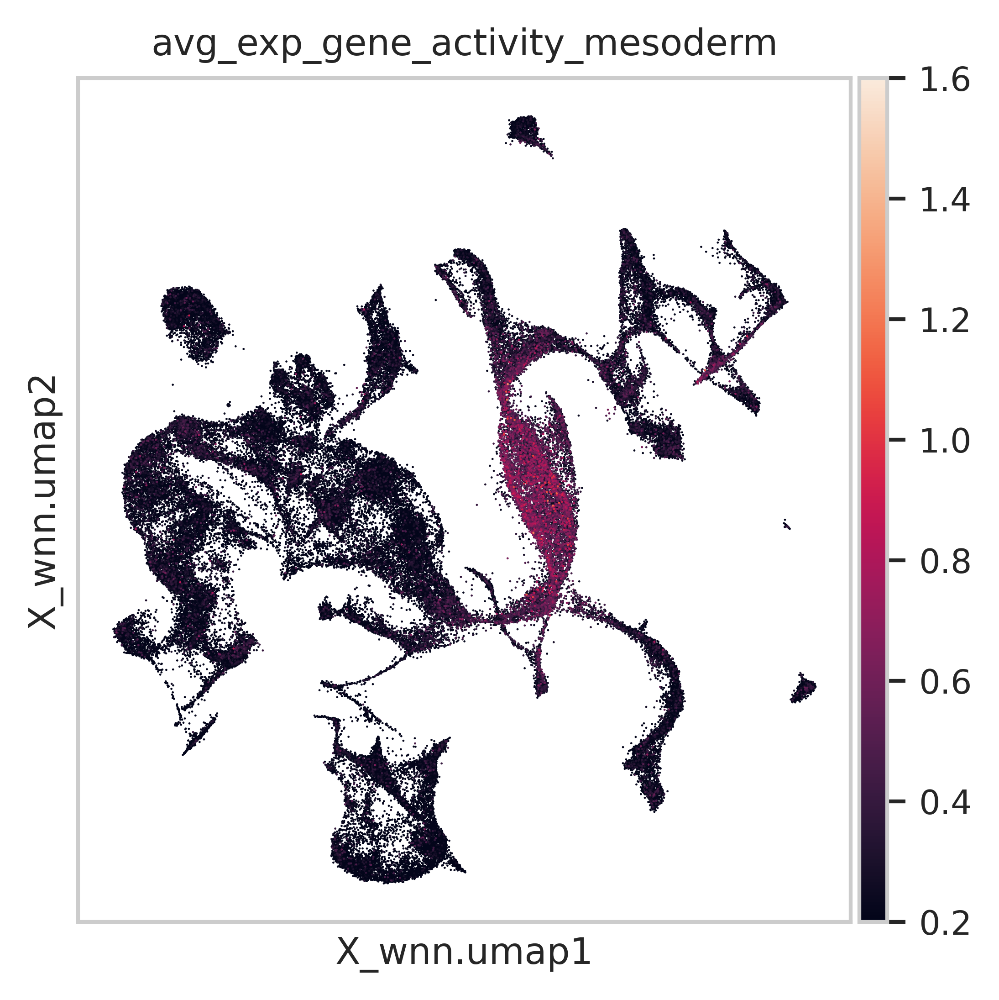

['pax7a', 'pax6a', 'pax6b', 'col18a1a', 'en2b', 'znf536', 'gpm6aa', 'gli3', 'chl1a']


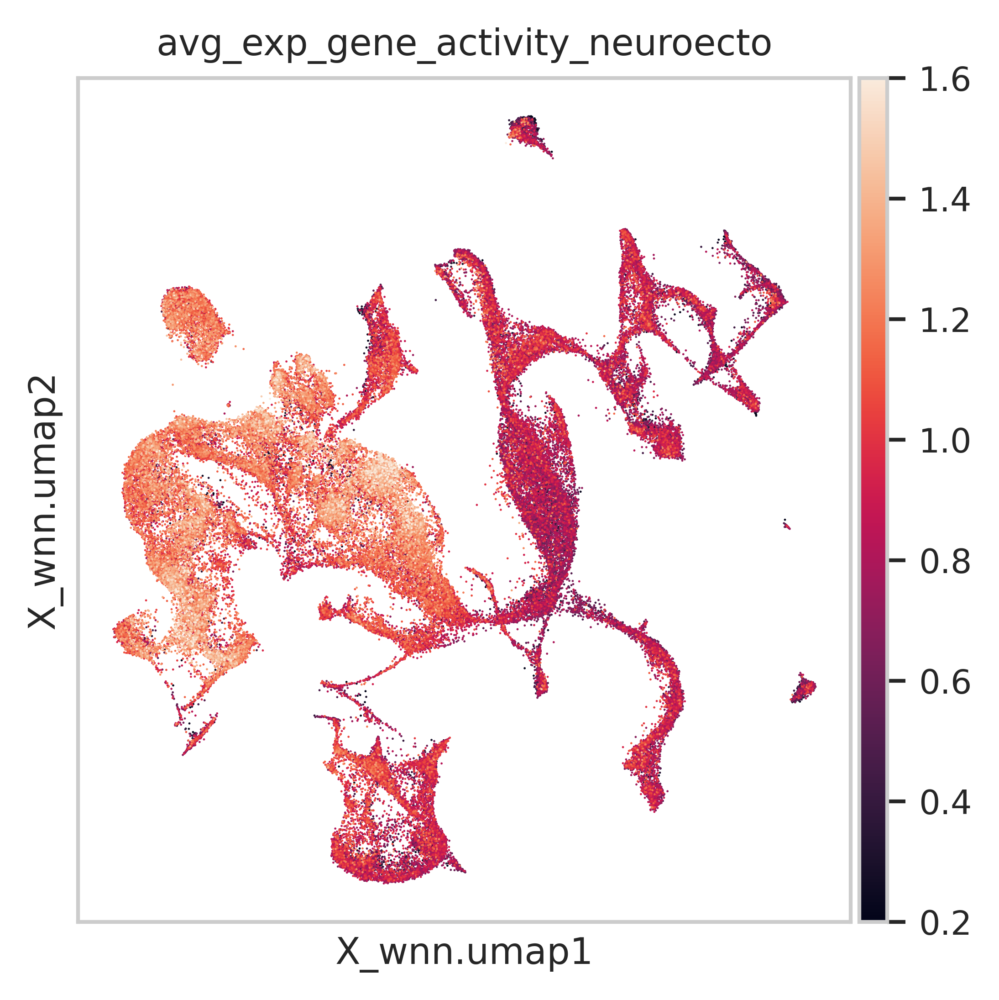

['lmo2', 'etv2', 'tal1', 'sox17']


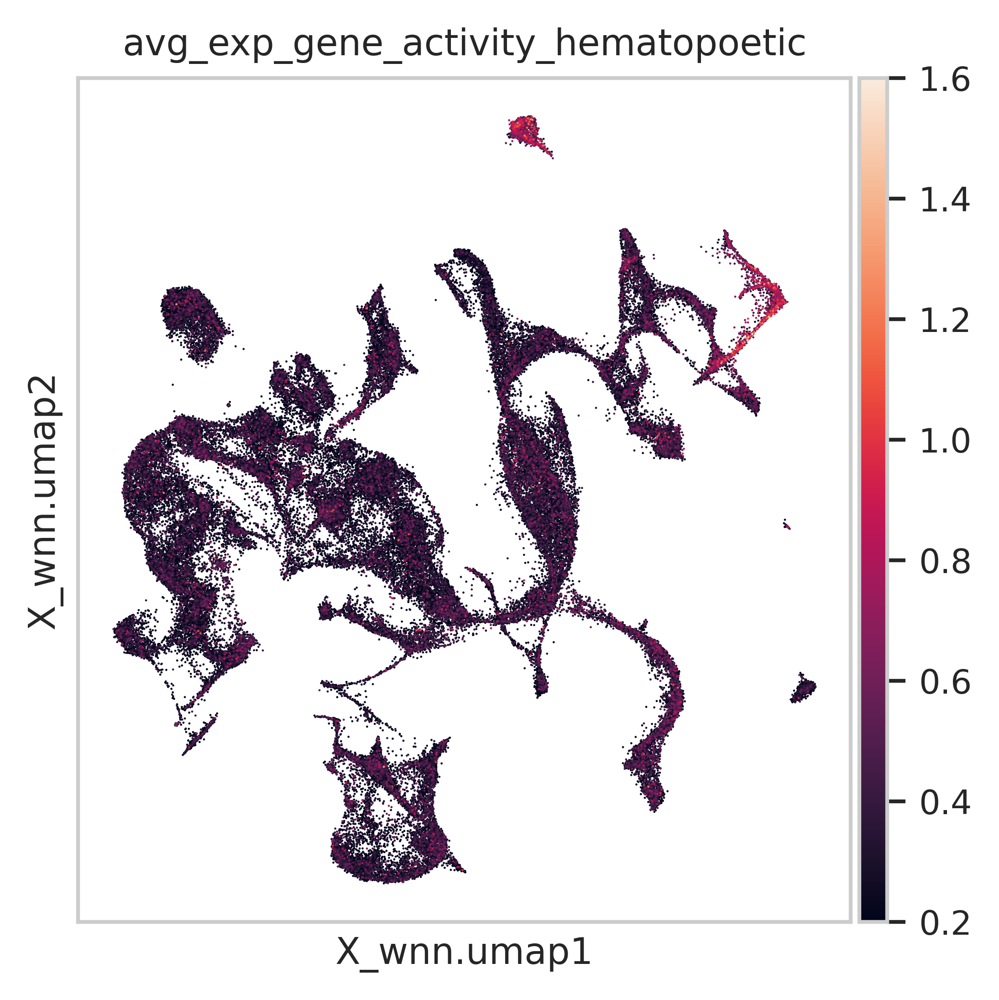

In [19]:
list_tissues_markers = [markers_endo, markers_meso, markers_neuro, markers_hemato]
list_tissues_markers

list_tissues = ["endoderm", "mesoderm", "neuroecto", "hematopoetic"]

for index, tissue_markers in enumerate(list_tissues_markers):
    print(tissue_markers)
    # subset for the list of marker genes
    adata_sub = multiome_ga[:,multiome_ga.var_names.isin(tissue_markers)]

#     adata_sub.X = adata_sub.layers["counts"].copy()

#     sc.pp.normalize_total(adata_sub, target_sum=1e4)
#     sc.pp.log1p(adata_sub)
    
    # add the obs field to the main object (multiome)
    tissue = list_tissues[index]
    multiome_ga.obs[f"avg_exp_gene_activity_{tissue}"] = np.mean(adata_sub.X.todense(),axis=1)
    with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
        sc.pl.embedding(multiome_ga, basis="X_wnn.umap", color=f"avg_exp_gene_activity_{tissue}", save=f"_{tissue}_markers_gene_activity.png",
                        vmin=0.2, vmax=1.6)

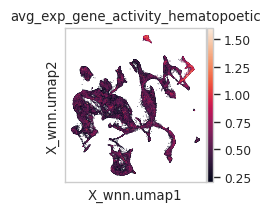

In [20]:
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.embedding(multiome_ga, basis="X_wnn.umap", color=f"avg_exp_gene_activity_{tissue}", save=f"_{tissue}_markers_gene_activity.pdf",
                    vmin=0.2, vmax=1.6)

## (deprecated) - computing the fraction of celltypes at each timepoint

In [13]:
# Calculate the count of each cell-type within each dataset
cell_type_counts = adata.obs.groupby(['dataset', 'global_annotation']).size().unstack(fill_value=0)

# Calculate the fraction of each cell-type within each dataset
cell_type_fractions = cell_type_counts.div(cell_type_counts.sum(axis=1), axis=0)

In [14]:
cell_type_fractions

global_annotation,Adaxial_Cells,Differentiating_Neurons,Endoderm,Epidermal,Lateral_Mesoderm,Muscle,NMPs,Neural_Anterior,Neural_Crest,Neural_Posterior,Notochord,PSM,Somites
dataset,,,,,,,,,,,,,
TDR118,0.009570,0.023999,0.035998,0.110130,0.143846,0.033274,0.006699,0.320009,0.074205,0.127577,0.005963,0.057936,0.050795
TDR119,0.006427,0.023058,0.049409,0.158592,0.130955,0.016148,0.008677,0.306741,0.070941,0.126778,0.004017,0.058729,0.039528
TDR124,0.030447,0.108593,0.011333,0.191137,0.000000,0.014547,0.000000,0.098106,0.010995,0.481055,0.000169,0.012855,0.040765
TDR125,0.000000,0.038082,0.000755,0.105306,0.125508,0.051260,0.010972,0.265993,0.053117,0.279810,0.001974,0.026007,0.041217
TDR126,0.000000,0.017584,0.045588,0.136356,0.151661,0.018724,0.043146,0.196679,0.009769,0.195946,0.019131,0.093699,0.071719
TDR127,0.000000,0.016510,0.049424,0.133673,0.126825,0.014493,0.025747,0.240272,0.035834,0.198545,0.009715,0.100016,0.048946
TDR128,0.000000,0.018375,0.054932,0.159284,0.145841,0.030658,0.017408,0.105126,0.059091,0.286944,0.002901,0.073308,0.046132


In [15]:
# Prepare the DataFrame for plotting
data_for_plotting = cell_type_fractions.stack().reset_index()
data_for_plotting.columns = ['dataset', 'cell_type', 'fraction']

In [32]:
set_plotting_style()

/tmp/ipykernel_4489/1109582874.py:12: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-paper')


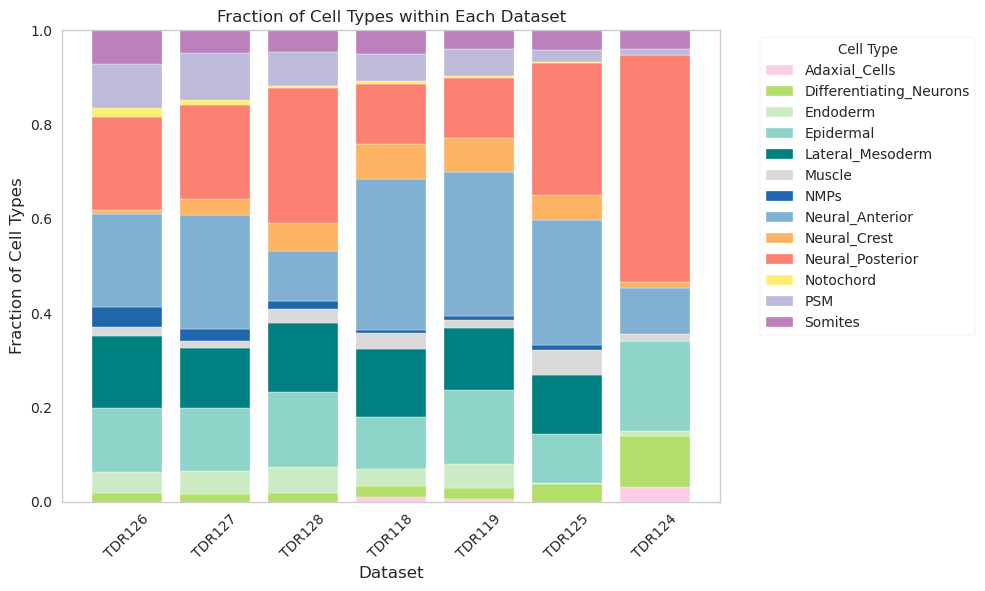

In [70]:
# order of the datasets
order_datasets = ["TDR126","TDR127","TDR128","TDR118","TDR119","TDR125","TDR124"]

# Reorder the DataFrame according to your specific dataset order
cell_type_fractions = cell_type_fractions.reindex(order_datasets)

# Unique datasets and cell-types
datasets = cell_type_fractions.index.tolist()
cell_types = cell_type_fractions.columns.tolist()

# Initialize the bottom parameter for stacking
bottom = pd.Series([0] * len(datasets), index=datasets)

# Plot each cell-type fraction
plt.figure(figsize=(10, 6))
for cell_type in cell_types:
    plt.bar(datasets, cell_type_fractions[cell_type], bottom=bottom, 
            label=cell_type, color=custom_palette[cell_type])
    bottom += cell_type_fractions[cell_type]

plt.xticks(rotation=45)
plt.ylabel('Fraction of Cell Types')
plt.xlabel('Dataset')
plt.title('Fraction of Cell Types within Each Dataset')
plt.ylim(0, 1)  # Ensure y-axis maxes at 1
# Remove grid lines
plt.grid(False)
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.savefig(figpath + "frac_celltypes_timepoints.pdf")
plt.savefig(figpath + "frac_celltypes_timepoints.png")
plt.show()

In [80]:
cell_type_fractions['TDR118_TDR119_avg'] = cell_type_fractions.loc[['TDR118', 'TDR119']].mean()
cell_type_fractions

global_annotation,Adaxial_Cells,Differentiating_Neurons,Endoderm,Epidermal,Lateral_Mesoderm,Muscle,NMPs,Neural_Anterior,Neural_Crest,Neural_Posterior,Notochord,PSM,Somites,TDR118_TDR119_avg
dataset,,,,,,,,,,,,,,
TDR118,0.009570,0.023999,0.035998,0.110130,0.143846,0.033274,0.006699,0.320009,0.074205,0.127577,0.005963,0.057936,0.050795,NaN
TDR119,0.006427,0.023058,0.049409,0.158592,0.130955,0.016148,0.008677,0.306741,0.070941,0.126778,0.004017,0.058729,0.039528,NaN
TDR124,0.030447,0.108593,0.011333,0.191137,0.000000,0.014547,0.000000,0.098106,0.010995,0.481055,0.000169,0.012855,0.040765,NaN
TDR125,0.000000,0.038082,0.000755,0.105306,0.125508,0.051260,0.010972,0.265993,0.053117,0.279810,0.001974,0.026007,0.041217,NaN
TDR126,0.000000,0.017584,0.045588,0.136356,0.151661,0.018724,0.043146,0.196679,0.009769,0.195946,0.019131,0.093699,0.071719,NaN
TDR127,0.000000,0.016510,0.049424,0.133673,0.126825,0.014493,0.025747,0.240272,0.035834,0.198545,0.009715,0.100016,0.048946,NaN
TDR128,0.000000,0.018375,0.054932,0.159284,0.145841,0.030658,0.017408,0.105126,0.059091,0.286944,0.002901,0.073308,0.046132,NaN


In [81]:
# plotting over the timecourse
# average the cell type frequencies between TDR118 and TDR119 (biological replicates)
# order of the datasets
order_datasets = ["TDR126","TDR127","TDR128","TDR118","TDR119","TDR125","TDR124"]

# Reorder the DataFrame according to your specific dataset order
cell_type_fractions = cell_type_fractions.reindex(order_datasets)

# Calculate the average of the fractions for TDR118 and TDR119
average_TDR118_TDR119 = cell_type_fractions.loc[['TDR118', 'TDR119']].mean(axis=0)

# Add the averaged fractions back into the DataFrame with a new label
cell_type_fractions.loc['TDR118_TDR119_avg'] = average_TDR118_TDR119

# Drop the original TDR118 and TDR119 rows
cell_type_fractions.drop(['TDR118', 'TDR119'], axis=0, inplace=True)

# Add the averaged column in the desired order
order_datasets_with_avg = ["TDR126","TDR127","TDR128","TDR118_TDR119_avg","TDR125","TDR124"]
cell_type_fractions = cell_type_fractions.reindex(order_datasets_with_avg)

# Dictionary for mapping datasets to developmental stages
dict_dev_stages_v2 = {
    'TDR118_TDR119_avg': '15somites',  # Add the averaged stage here
    'TDR124': '30somites',
    'TDR125': '20somites',
    'TDR126': '0somites',
    'TDR127': '5somites',
    'TDR128': '10somites'
}

# Rename the index using dict_dev_stages to reflect developmental stages
cell_type_fractions.rename(index=dict_dev_stages_v2, inplace=True)

KeyError: 'TDR118_TDR119_avg'

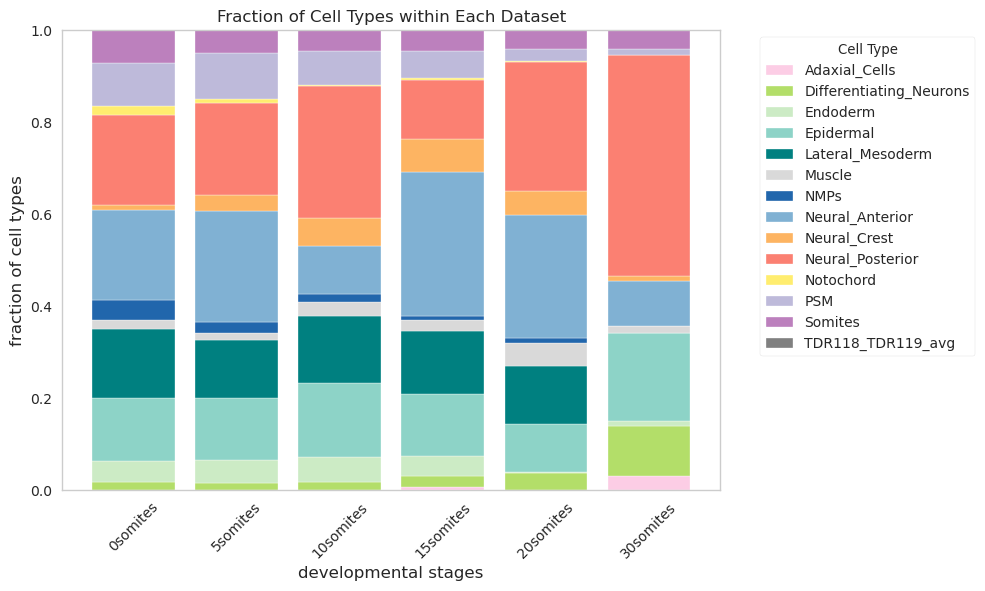

In [87]:
# Unique datasets and cell-types
datasets = cell_type_fractions.index.tolist()
cell_types = cell_type_fractions.columns.tolist()

# Initialize the bottom parameter for stacking
bottom = pd.Series([0] * len(datasets), index=datasets)

# Plot each cell-type fraction
plt.figure(figsize=(10, 6))
for cell_type in cell_types:
    # Use the get method to provide a default color if the key doesn't exist
    color = custom_palette.get(cell_type, "grey")  # Default color set to "grey"
    plt.bar(datasets, cell_type_fractions[cell_type],
            bottom=bottom, label=cell_type, color=color)
    bottom += cell_type_fractions[cell_type]

plt.xticks(rotation=45)
plt.ylabel('fraction of cell types')
plt.xlabel('developmental stages')
plt.title('Fraction of Cell Types within Each Dataset')
plt.ylim(0, 1)  # Ensure y-axis maxes at 1
# Remove grid lines
plt.grid(False)
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
# Replace 'figpath' with the actual path where you want to save the figures
plt.savefig(figpath + "frac_celltypes_dev_stages.pdf")
plt.savefig(figpath + "frac_celltypes_dev_stages.png")
plt.show()

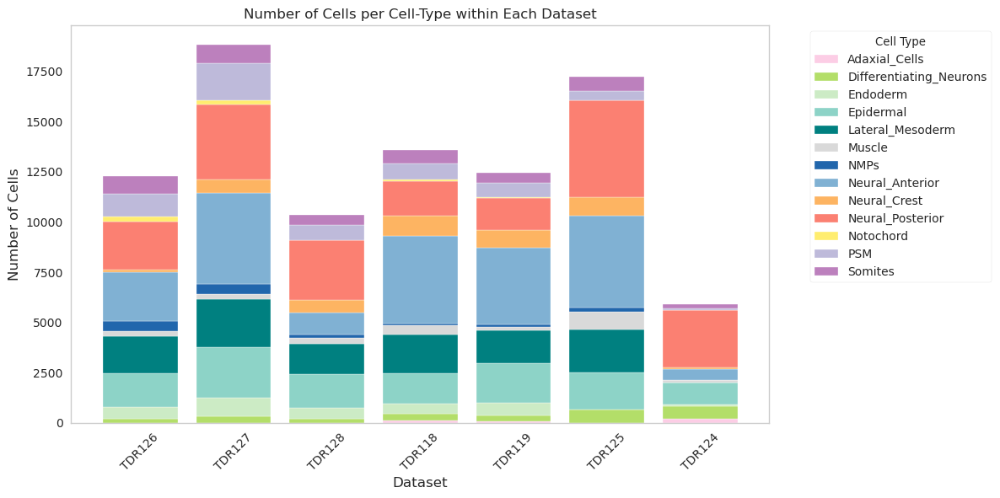

In [88]:
# Assuming you've already defined an appropriate color palette
# For this example, let's reuse the unique extended_set2_palette for coloring

order_datasets = ["TDR126","TDR127","TDR128","TDR118","TDR119","TDR125","TDR124"]

# Reorder the DataFrame according to your specific dataset order
cell_type_counts = cell_type_counts.reindex(order_datasets)

# Plot
plt.figure(figsize=(12, 6))
bottom = None
for cell_type in cell_type_counts.columns:
    # Check if bottom has been initialized
    if bottom is None:
        bottom = [0] * cell_type_counts.shape[0]
    plt.bar(cell_type_counts.index, cell_type_counts[cell_type], 
            bottom=bottom, label=cell_type, color=custom_palette[cell_type])
    # Update bottom for the next cell type
    bottom = [left + height for left, height in zip(bottom, cell_type_counts[cell_type])]

plt.xticks(rotation=45)
plt.ylabel('Number of Cells')
plt.xlabel('Dataset')
plt.title('Number of Cells per Cell-Type within Each Dataset')
# Remove grid lines
plt.grid(False)
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.savefig(figpath + "num_celltypes_timepoints.pdf")
plt.savefig(figpath + "num_celltypes_timepoints.png")
plt.show()